In [3]:
import nltk
import re
from nltk.corpus import stopwords

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import sqlite3
import pickle
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer

from sklearn.manifold import TSNE

In [5]:
import gensim
from sklearn.manifold import TSNE 

C:\Users\Pratheesh\Anaconda3\lib\site-packages\gensim\utils.py:860: UserWarning: detected Windows; aliasing chunkize to chunkize_serial
  warnings.warn("detected Windows; aliasing chunkize to chunkize_serial")


In [5]:
conn=sqlite3.connect('database.sqlite')

filtered_data= pd.read_sql_query("""
SELECT *
FROM Reviews
WHERE Score!=3
""",conn)
conn.close()
filtered_data.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [7]:
def partition(x):
    if x>3:
        return 'positive'
    return 'negative'

filtered_data['Score']=filtered_data['Score'].map(partition)

In [8]:
filtered_data.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,positive,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,negative,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,positive,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,negative,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,positive,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [9]:
sorted_data = filtered_data.sort_values('ProductId')

In [10]:
sorted_data.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...
138688,150506,0006641040,A2IW4PEEKO2R0U,Tracy,1,1,positive,1194739200,"Love the book, miss the hard cover version","I grew up reading these Sendak books, and watc..."
138689,150507,0006641040,A1S4A3IQ2MU7V4,"sally sue ""sally sue""",1,1,positive,1191456000,chicken soup with rice months,This is a fun way for children to learn their ...
138690,150508,0006641040,AZGXZ2UUK6X,"Catherine Hallberg ""(Kate)""",1,1,positive,1076025600,a good swingy rhythm for reading aloud,This is a great little book to read aloud- it ...
138691,150509,0006641040,A3CMRKGE0P909G,Teresa,3,4,positive,1018396800,A great way to learn the months,This is a book of poetry about the months of t...


In [11]:
sorted_data.shape

(525814, 10)

In [12]:
final = sorted_data.drop_duplicates(subset={"UserId","ProfileName","Time","Text"})
final.shape

(364173, 10)

In [13]:
final=final[final.HelpfulnessNumerator<=final.HelpfulnessDenominator]
final.shape

(364171, 10)

In [14]:
final['Score'].value_counts()

positive    307061
negative     57110
Name: Score, dtype: int64

In [15]:
#Saving the cleaned data in a new database
#conn=sqlite3.connect('final.sqlite')
#c=conn.cursor()
#final.to_sql("Reviews",conn,if_exists='replace')
#conn.close()

In [16]:
x=[1,2,3,4,5,6]


In [17]:
with open('dummy.pkl','wb') as f:
    pickle.dump(x,f)

In [18]:
with open('dummy.pkl','rb') as f:
    y= pickle.load(f)

In [19]:
y

[1, 2, 3, 4, 5, 6]

In [6]:
conn=sqlite3.connect('final.sqlite')
final= pd.read_sql_query('Select * From Reviews',conn)
final.head()

,level_0,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText
0,0,138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...
1,1,138688,150506,0006641040,A2IW4PEEKO2R0U,Tracy,1,1,positive,1194739200,"Love the book, miss the hard cover version","I grew up reading these Sendak books, and watc...",grew read sendak book watch realli rosi movi i...
2,2,138689,150507,0006641040,A1S4A3IQ2MU7V4,"sally sue ""sally sue""",1,1,positive,1191456000,chicken soup with rice months,This is a fun way for children to learn their ...,fun way children learn month year learn poem t...
3,3,138690,150508,0006641040,AZGXZ2UUK6X,"Catherine Hallberg ""(Kate)""",1,1,positive,1076025600,a good swingy rhythm for reading aloud,This is a great little book to read aloud- it ...,great littl book read nice rhythm well good re...
4,4,138691,150509,0006641040,A3CMRKGE0P909G,Teresa,3,4,positive,1018396800,A great way to learn the months,This is a book of poetry about the months of t...,book poetri month year goe month cute littl po...


In [21]:
#Bag Of Words
bow_vect= CountVectorizer()
bow=bow_vect.fit_transform(final['Text'].values)

In [22]:
bow.get_shape()

(364171, 115281)

In [5]:
#TF-IDF
tf_idf_vect=TfidfVectorizer()
tf_idf=tf_idf_vect.fit_transform(final['Text'].values)

In [24]:
tf_idf.shape

(364171, 115281)

In [25]:
#Text Preprocessing
stop = set(stopwords.words('english'))  #stopwords

In [ ]:
nltk.download()

showing info https://raw.githubusercontent.com/nltk/nltk_data/gh-pages/index.xml


In [27]:
print(stop)

{'theirs', 'couldn', 'be', 'mustn', "won't", 'before', 'its', 'her', "you're", 'are', "it's", 'shan', 'if', 'again', "doesn't", 'between', 'why', 'my', 'have', 'with', 'don', 'and', 'more', 'these', 'does', 'having', 'above', "isn't", 'the', 'should', 'hers', 'whom', 'wouldn', 'no', 'too', 'each', 'as', "shouldn't", 'from', 'them', 'because', 'shouldn', 'being', 'over', 'when', 'nor', "mustn't", 'we', 'themselves', "you'll", 'wasn', "haven't", 'your', 'itself', 'not', 'own', 'll', 'during', 'i', "shan't", 'up', 't', 'than', 'myself', 'at', 'so', 'then', 'was', 'here', 'all', 'down', 'ain', 'mightn', 'weren', 'y', 'has', "wasn't", 'is', 'yourself', 'his', 'same', 'ourselves', 'to', 'm', 'by', 'about', 'their', 'other', 'both', 'most', 'did', 'she', 'd', 'into', 'once', "wouldn't", 'won', 'on', "weren't", 'few', 'himself', 'they', 'will', "couldn't", 'haven', 'now', "she's", 'do', 'some', 'been', 'an', 'can', 'yourselves', 'of', 'while', 'that', 'hadn', 'aren', 'had', 'any', 'who', "didn

In [28]:
lst = ['against']
for word in lst:
    stop.remove(word)
print(stop)

{'theirs', 'couldn', 'be', 'mustn', "won't", 'before', 'its', 'her', "you're", 'are', "it's", 'shan', 'if', 'again', "doesn't", 'between', 'why', 'my', 'have', 'with', 'don', 'and', 'more', 'these', 'does', 'having', 'above', "isn't", 'the', 'should', 'hers', 'whom', 'wouldn', 'no', 'too', 'each', 'as', "shouldn't", 'from', 'them', 'because', 'shouldn', 'being', 'over', 'when', 'nor', "mustn't", 'we', 'themselves', "you'll", 'wasn', "haven't", 'your', 'itself', 'not', 'own', 'll', 'during', 'i', "shan't", 'up', 't', 'than', 'myself', 'at', 'so', 'then', 'was', 'here', 'all', 'down', 'ain', 'mightn', 'weren', 'y', 'has', "wasn't", 'is', 'yourself', 'his', 'same', 'ourselves', 'to', 'm', 'by', 'about', 'their', 'other', 'both', 'most', 'did', 'she', 'd', 'into', 'once', "wouldn't", 'won', 'on', "weren't", 'few', 'himself', 'they', 'will', "couldn't", 'haven', 'now', "she's", 'do', 'some', 'been', 'an', 'can', 'yourselves', 'of', 'while', 'that', 'hadn', 'aren', 'had', 'any', 'who', "didn

In [29]:
#Stemming
sno = nltk.stem.SnowballStemmer('english')  #Intializing snowball stemmer

In [30]:
#Function to clean html tags
def cleanhtml(sentence):
    cleanr = re.compile('<.*?>')
    cleantext=re.sub(cleanr,' ', sentence)
    return cleantext

In [31]:
cleanhtml("hello<br  /br>World")

'hello World'

In [32]:
#Function to remove punctuatuions and special characters
def cleanpunc(sentence):
    cleaned=re.sub(r'[?|@|!|^|%|\'|"|#]',r'',sentence)
    cleaned=re.sub(r'[.|,|)|(|\|/]',r' ',cleaned)
    return cleaned

In [33]:
cleanpunc("H?e^l@l/o #W(o!r%^ld,.)")

'Hell o W orld   '

In [34]:
#Function for text preprocessing
def preprocessing(series):
    i = 0
    str1= ' '
    final_string=[]
    list_of_sent=[]
    
    all_positive_words=[]
    all_negative_words=[]
    
    for sent in series.values:
        filtered_sent=[]
        list_of_sent=[]
        sent=cleanhtml(sent)   #Cleaning HTML Tags
        sent=cleanpunc(sent)   #Cleaning punctuation and special char
        
        for cleaned_words in sent.split():
            if((cleaned_words.isalpha()) & (len(cleaned_words)>2)):
                if(cleaned_words.lower() not in stop):
                    s= (sno.stem(cleaned_words.lower()))
                    filtered_sent.append(s)
                    if(final['Score'].values)[i]=='positive':
                        all_positive_words.append(s)
                    if(final['Score'].values[i]=='negative'):
                        all_negative_words.append(s)
        list_of_sent.append(filtered_sent)
        
        str1=" ".join(filtered_sent)
        
        final_string.append(str1)
        
        i+=1
    return final_string, list_of_sent
            

In [35]:
final_string,list_of_sent = preprocessing(final['Text'])

In [60]:
#First five rows without preprocessing
for x in final['Text'].iloc[:5].values:
    print(x,"\n\n")

this witty little book makes my son laugh at loud. i recite it in the car as we're driving along and he always can sing the refrain. he's learned about whales, India, drooping roses:  i love all the new words this book  introduces and the silliness of it all.  this is a classic book i am  willing to bet my son will STILL be able to recite from memory when he is  in college 


I grew up reading these Sendak books, and watching the Really Rosie movie that incorporates them, and love them. My son loves them too. I do however, miss the hard cover version. The paperbacks seem kind of flimsy and it takes two hands to keep the pages open. 


This is a fun way for children to learn their months of the year!  We will learn all of the poems throughout the school year.  they like the handmotions which I invent for each poem. 


This is a great little book to read aloud- it has a nice rhythm as well as good repetition that little ones like, in the lines about "chicken soup with rice".  The child g

In [37]:
#First five rows after preprocesing
for x in final_string:
    print(x,"\n\n")

witti littl book make son laugh loud recit car drive along alway sing refrain hes learn whale india droop love new word book introduc silli classic book will bet son still abl recit memori colleg 


grew read sendak book watch realli rosi movi incorpor love son love howev miss hard cover version paperback seem kind flimsi take two hand keep page open 


fun way children learn month year learn poem throughout school year like handmot invent poem 


great littl book read nice rhythm well good repetit littl one like line chicken soup rice child get month year wonder place like bombay nile eat well know get eat kid mauric sendak version ice skate treat rose head long time wont even know came surpris came littl witti book 


book poetri month year goe month cute littl poem along love book realli fun way learn month poem creativ author purpos write book give children fun way learn month children also learn thing poetri rhythm read book 


charm rhyme book describ circumst eat dont chicken so

min recent bought pair see effect bought two number review mention instruct lack although trap actual simpl set wouldnt know instruct pretti cryptic illustr especi tough follow decid film instruct show think watch see easi set trap purchas trap find help learn set 


recent purchas woodstream corp gopher trap within minut lay trap catch gopher product best ever use gopher trap easi set work great success also rememb use wire attach trap tie steak prevent gopher drag trap hole caught hope find product easi use good luck 


may figur set right hole take get good catch realli put signific dent golpher popul attack garden 


call easi set instruct includ wrong look like broken finger instruct pleas victor easi set gopher trap 


poor excus gopher trap lot gopher use trap recent bought four set trap ill design gopher abl trip without get caught even manag push set trap hole problem sweep pincer wide mechan easili clog sand dirt dont bother trap 


order victor easi set gopher trap exhaust m

dog love chew invalu dog love cant keep enough hous 


origin purchas one puppi brought home six month chew dino head tail good shape lost dino month found becom destruct chew destroy stuf anim minut sometim less new dino happi tri chew dont nub seem enjoy purchas back dino case ever lose one kept troubl chew great product cavali would give larg breed dog think would small dental dinosaur nylabon 


dog love chew toy daughter dog well alway sever around hous 


toy excel golden retriev teeth perfect product descript accur pictur show receiv brontosaurus big deal multipl model descript indic one your get 


decid tri product previous bought nylabon pro action dental dog chew great result must say far good although given choic choos dinosaur shape beagl jack russel mix mind love new stegosaurus previous like product last month littl dog constant chew occasion chomp basset hound 


normal buy larg super durabl nylabon shepherd mix howev sale decid give one tri dog love bone soon arriv how

dog seem like fine give holist select product due sensit gastrointestin system 


noth against product bother link top page buy use chew gum lose flavor bedpost overnight andi alaska 


love stuff doesnt rot gum tast good go buy gum get 


tenni player hubbi mine got pack rack opel corsa casual start cherish peppermint flavour gotta last refresh flavour best part real mouth freshner keep teeth whiter feel good chew long time normal indian prefer lunch dinner prefer chew gum refresh tast bud good pick 


nice litt perfect cup herbal tea go bed 


set work great use use chees cloth bag tea drop herb steep wah tea easi clean get sediment use lot loos herb expect 


sediment fall bottom found usual occur first put tea hold tea contain tin load give littl shake settl anyth fall fall back possess later use littl fall add water tea swell bit make difficult get small hole cup larger use welcom chang sure size big gulp cup review use tea one certain adequ also realli like watch tea brew clear g

thrill find amazon purchas cost plus longer carri would agre drink straight probabl peopl like tast like soda howev like negroni combin orang juic highbal glass ice tast like negroni without alcohol also look beauti serv without stir allow orang merg red garnish swizzl stick orang slice bottl small cool graphic save use individu flower vase outdoor parti 


best nonalcohol bitter abl find internet price reason packag done well 


bitter red sanbitt pellegrino first tast somewhat shock flavor settl becom clean refresh extrem accept altern alcohol aper must add splash take bellini 


made wish born without tast bud tast sicken sweet first absolut horribl disgust bitter aftertast tast like would poison anyon suggest might actual drinkabl let know nine thing sit refriger 


tri offend anyon soda definit aquir tast first bottl drawn amaz packag love anyth italian ugh swear threw mouth stay away cannot toler smell tast vomit heard tast better bitter cannot stomach anoth sip 


longer drink a

hot sauc might imagin spici faint heart drop salsa give real good kick tri straight probabl way much even season connoisseur luckili straight heat there nice smoki flavor give whatev put nice flavor underton would make great addit hot sauc collect need one bottl someth make friend squirm 


bourbena autunno australia foglio dimmi dimmi dimi voglio supr dutto dimm non pice turbon pice bourbon occhi azzuri gli nuvoloso rosso hail might safra bourbon 


tri dave ghost pepper sauc realli impress heat flavor want someth lot heat lot flavor time great choic work hot wing joint hot pretti warm custom sometim place order want hot get put three drop hot wing wow didnt want finish wing heat come strong second last minut well think talk boss let use one order custom want hot get guarante much anyon flavor realli smooth well littl smokey much far heat goe scale one ten would give 


definit one better tast hot sauc hottest market addit fruit ingredi wasnt made hottest tri ketchup french fri ketchu

satisfi smoke salmon tasti also deliv prompt would order 


friend south texa know much smoke salmon peopl wisconsin know rais cattl purpos drain milk everyon purchas product said great cracker suppos accept present smokey flavor made appar qualiti salmon anyway bought gift item sever time everyon said like friend type would tell someth tast like excrement like smoke salmon look good gift someon like smoke item appar cant wrong purchas product 


salmon isnt good qualiti compar fresh smoke salmon alaska main necessari box made china would much rather pay cent american made product remind walmart close roll pin manufactur facil near town main move product china save cent per roll pin unbeliev disgust 


english husband ask consum one sit idea much meal would cost savoy felt fantast indulg happi 


thought grav lox realli smoke fish tast awesom expect 


smoke salmon absolut disgust box neat also put togeth poor china would recommend buy dont wast money 


purchas item christma gift two 

heard iron beer never actual chanc tri unlik materva relat easi get even south carolina ive never much seen iron beer shelf went ahead took plung order onlin surpris definit remind mix cream soda orang soda anoth review said tast like orang dreamsicl pretti actual somehow manag lot sum part mayb hint island spice high recommend want someth new simpli want tast home 


sure made mexico came soda made miami origin cuba agre anoth poster also live south florida easili avail better price would howev pay price live area sweet soda think tropic pepper 


pleas found amazon love tast kid love milk 


los dios azteca comian esta galleta fabulosa quiero invertir bolsa valor fritolay sere millonario sabor mejor hace lengua vibrar mmmmm sabor artifici 


exact rememb great flavor qualiti use eat child happi find onlin great snack adult children 


daughter love flavor like flavor compani drink milk mix year 


absolut love mango juic packag arriv pretti quick tast delici sweet tast squeez mango 


best tea go david rio suppli year first thing morn vanilla best 


girlfriend love chai tri differ kind think one best tast like sugarfre product usual use low carb milk instead water make drink creamier put much powder drink problem dissolv 


sooo happi found could purchas onlin ive tri lot chai tea latt alway come back one wonder full tast appreci mix complet dissolv usual use half milk half water make mine oooooh heaven henderson saxbi carri brand addict move state took long time find chai even close noth compar come starbuck start serv david rio chai custom life thank good order onlin 


look chai product that sugar free make sure read fine print maltodextrin clear equal glucos sugar cup wife glucos level realli think cup might work product tast good dale 


miss general food intern sugar free chai latt drink enough pay could find also know sinc longer produc find old stock look everywher find someth good find david rio orcha spice chai good easi find intranet 


chai product grea

mani weekend spent loincloth knife clench teeth run field tri find rabbit bunch trust bunch someth sacrific altar get cave home fix cocktail day mail finish drink drive cave yank carcass box offer feet dark lord master boom done happi dark lord master happi everybodi win time saver 


expect harder sausag satifi flavor qualiti garlic sausag flavor strong garlic expens would buy 


want spend ship item place 


syrup illustr french stay dont drink soda drink syrup way work crave refresh tasti drink pour tablespoon syrup glass cover cold water seltzer prefer voila mint version refresh wake mind better keep bottl work 


trip pari visit maill store hundr differ flavor dijon mustard select smaller bottl poivr vert normal size wonder quick realiz lucki brought home mani poivr vert dijon green peppercorn difficult explain except base famili favorit salad dress big fan plain dijon mustard combo make amaz mustard first use turkey burger rare eat beef found mustard felt though sacrif everi time

got spoil brand friend south africa blend dont tast 


love trip africa husband coffe drinker found tea perfect drink everi morn hunt happi abl find amazon tea everi day thank million 


husband safari south africa rooibo experi state alway mix someth els freshpak south african buy great flavor cheap even pick lipton rooibo found like freshpak much better tea becam friend day weather made feel better peopl swear littl honey lemon drink day brought tea famili friend havent heard even tri might steal back last bag need buy 


good tast full bodi tea drink palm cane sugar look forward look younger read magazin 


stuff amaz discov trip africa hook sinc incred healthi fantast tast say good stuff 


definit come back buy alreadi recommend sister also bought packag may help reduc bodi inflamm 


fantast product glad order one box like tea like freshpak rooisbo tea even dont like tea end tea lover first cup 


flavor also tast organ product fair trade organ version littl cost howev process di


curcumin plant pigment give spice characterist golden yellow orang color ive tri sever differ varieti turmer frontier organ come top term qualiti appear tast your get alleppey varieti record maximum color chemic analys turmer rhizom get basic good stuff simpl googl search yield wealth info explain numer health benefit power golden powder familiar never tast turmer deep earthi flavor somewhat pungent bitter somewhat acquir tast depend say bare tast most stain everyth eat along tupperwar trademark bright golden ting feel good cook effect also beauti front often use topic homemad facial mask mix togeth bit chickpea flour almond oil maintain glow skin pay organ yes use lot turmer everyday meal happen think worth your consum spice much higher volum use spare believ get bag that lbs turmer frontier clear sizabl price differ person choic obvious opt organ sever spice consum certain one regular keep mind organ doesnt realli mean better much simpli ensur food grown without use pesticid synthet


tast product good like reorder againi wish could purchas omaha nebrit arriv time fashion might tri 


refus drink anyth high fructos corn syrup hate nasti tast everi artifici sweeten leav sugar drink prefer attent reduc level sugar wont find much choic local groceri store least part store make financi deal carbon drink manufactur boylan cola root beer favorit flavor one avail brand even whole food drop favor anoth brand wont mention dont care like mexican coke give boylan tri think superior tast realli good thing boylan drink avail free ship sinc weigh vendor amazon charg ship take care figur actual total cost product plus ship last ill note web boylan drink usual expens store find local store 


best stuff ive drink pepsi year alway like later discov still cola use real sugar instead high fructos corn syrup order boylan cola red rock cola onlin like better cola ive go drink cola except red rock also good smaller compani unaffect corpor greed make use cheaper ingredi 


best cola bar 

espresso fan must tri blend smooth fabul tast price nice cafe kimbo espresso forev 


great product pepper veget mix heat level tast servic outstand thank 


make lot homemad salad dress recip call wine vinegar balsam vinegar use chianti red wine vinegar wine vinegar either sharp wateri balsam vinegar sweet tast use particular brand year reliabl sourc amazon com hope dal raccoloto never stop make stuff 


best champagn vinegar found intens sour nice flavor add packag stevia sweeten juic orang love fat free salad dress 


recent begun use brand exclus here colavita extra virgin oliv oil impress list credenti clear set apart maker oliv oil particular product boast certif intern standard organ certifi authent product itali best oliv oliv oil grown best condit natur product oliv oil noth ad excel tast nutrit compon tablespoon oliv oil contain calori gram fat cholesterol percent fat oliv oil monounsatur nine percent polyunsatur fourteen percent satur fat virgin oliv oil also contain antioxi


curri assort great way sampl differ curri afford price curri past quick easi way spice almost dish 


mother live rural part countri ohio nativ thailand anyway small town easi find thai anyth make easi send littl tast home front door prompt ship pack 


bought caviar share year old grandmoth felt like queen told go caviar togeth impress care packag abil keep caviar appropri temp ship 


best american sturgeon caviar ive tri term tast even textur although textur still fall short import roe price big ship cost cant beat would order compani 


product hackleback sturgeon roe good problem supplier price one may purchas product marki exact caviar marki littl dollar dollar ship product also outrag like product get money marki caviar forget charleston seafood even call charleston abl help confront fact poor custom servic 


wonder damson preserv tast sinc grandmoth made home east coast usa earli treat gorgeous deep rubi preserv let delight soak put toast warm biscuit butter transport tast bu

think expens get local indian chines store california 


high doubt abl buy perhap regular dealer someth els sure buy indian chines saffron entir differ spanish saffron amateur 


tasti work perfect cooki recip two differ muffin batch didnt even occur first need vanilla extract substitut glad found definit buy 


your look powder substitut pure vanilla extract look first ingredi natur vanilla bean extract evapor cane juic silica cellulos wonder rich smell tast enhanc bake good substitut tsp powder tsp vanilla extract glad found 


husband want vanilla powder sprinkl morn latt search mani store couldnt find local supplier amazon great sourc like flavor shaker work well like size contain sinc wasnt order cook use larg contain pound bulk powder respons unhappi review nowher product claim pure vanilla two accur descript mention cane juic silica yes cane juic form sugar therefor sourc sweet silica miner common use flow agent powder also ingredi mani item includ glass fiber optic cosmet supp

cannot say enough product world treat famili desert serv 


second year use fill willl continu use long still bake 


hard find fact imposs find vermont sale store 


look sold store find anymor necessari decor sugar cooki christma arriv quick good packag 


larg packag silver drage exact size look sever left project high recommend 


receiv quick packag well correct amount qualiti definit compar one may buy groceri store cost bit less get bit 


eat kosher halal bad buy think ingredi put descript 


sugar cooki ornament longer avail state florida use decad somebodi decid silver silver drage substanc consum make christma cooki year use decor sugar cooki spritz wreath shape butter cooki search everywher happi find amazon tradit christma cooki look like alway famili member still aliv well consum decad happi holiday 


dull color mani bead misshap happi product 


awesom product love use detail cup cake cooki price right set order need 


foil cover coin ship time exact expect scatter din

love tea ever sinc littl girl honest say celesti season one favorit whimsic brand tea support habit drink health delici brew dont know anyon resist cozi box cheeri charm artwork pleas eye print recycl cardboard tea bag larg plain tast drop hot water worth bag look way cover art box realli make better tea brand fanci box shini label tast flat bitter madagascar vanilla red caffein free blend rooibo natur french vanilla flavor vanilla bean sugar honey even milk ad tast like sweetest almost chewi vanilla one sink teeth whenev sweet crave kick swear remind madagascar vanilla use bake intens headi sweet aroma tast like bakeri treati cup sinc healthi easi find inexpens make satisfi custom drink plain sugar noth tast like delic exot tea breath sweet one tea drink plain quit feat eye heartili recommend tea fan even dont think herbal caffein type tea cup tea haha better decaf natur caffein free omit artifici process simpli make happi drink 


love lion tea smooth earthi plus calm upset tummi 




seller imag match item ship purchas exact catnip local pet smart larg plastic cylind contain ident imag display seller amazon receiv shipment came small plastic bag item advertis imag weight 


love entertain give cat catnip goe crazi stuff pretti good go tri grow fresh soon see happen 


cat absolut nut give catnip quit amus watch 


ship well return reship two three open content spill cat dont like near much pick less walmart serious disappoint 


cat recent freak catnip came bed bought thought order couldnt find brand xtreme catnip sound like might trick even close husband swear saw cat lift paw yawn smell cat like mine youll probabl get better reaction catnip 


great cat love catnip except last issu sender 


kitti love stuff got littl cat hous kind littl cube hole cat crawl pour quarter cup catnip kitti enjoy herb bother 


first catnip ive bought seem best bang buck time purchas especi consid top rate brand amount price ive use toy rub finger packag direct etc yet three month ol

weve buy exact formula well cocker spaniel luci year thought would worth purchas amazon sinc price almost ident would conveni go petsmart sinc would deliv front door didnt receiv food well week order forc buy small bag store receiv food big deal figur next time well order coupl week advanc luci food suppli isnt low plenti get next bag feed two meal bag got amazon luci start violent diarrhea familiar fact chang food caus upset stomach dog exact food feed long time thought knew thing chang luci diet fact order food amazon went bought anoth small bag stuff petsmart much disappoint obvious differ appear food bag amazon chunk misshap porous even smell differ conclus amazon receiv reject bag discount sold product stop feed luci amazon bag switch back store bought bag immedi bowl improv although refund purchas jump hoop werent worth time wast pleas reconsid purchas food well amaz product proud feed littl luci best food possibl qualiti well known go post pic amazon bought food store bought foo

product advertis fresh wonder compani pleasur deal buy product near futur 


pleas order vanilla bean bean soft smell wonder order product 


superior vanilla bean come madagascar bourbon island mexico indonesia took year get courag buy vanilla bean found flavor truli superior vanilla extract dont want use vanilla bean everyth expens definit want consid use custard make ice cream vanilla enhanc everyth creami porridg custard cake list goe mani use vanilla vanilla deriv seduct aromat vanilla bean vanilla bean actual seed pod fragrant climb orchid nativ tropic america yes vanilla extract much econom use vanilla bean rather gourmet extract creat chop vanilla bean soak alcohol water solut take bean make gallon extract ive use piec vanilla bean food alway split middl also scrape vanilla superior vanilla flavor rebecca review 


expert never bought vanilla bean howev vanilla extract decid best way make split pair scissor drop cup vodka recip read vari less bean may buy add right enjoy aroma 

nice buy one decid need sorri review isnt technic method easi realli need explan 


hemp bag well construct easi use problem sprout mung bean stay incred small sprout bean batch mason jar day two size twice day seven bag batch rins schedul jar harder drain given differ end product think worth extra work havent tri lentil pea yet 


order suppos sweet pea seller couldnt wait tri sprout well bitter origin thought done someth wrong sprout process decid tri unsprout dri seed rins bitter even start sprout process contact seller direct let know may bad batch seller told peopl rave sweet pea say bitter ive garden year time pea bitter overrip seller tast test batch buy apolog garbanzo bean sprout bought tast fine think batch pea want get replac afraid would bitter well seller nice enough check lot number decid refund instead need amazon 


nice sweet grew pretti quick littl effort part high recommend anyon beginn advanc 


bitter tast pea mine came hemp bag sampl defin buy compani stop send sa

thought buy general tsos sauc accident order orang sauc kid chines food dont like sauc ginger overpow husband hand doesnt like chines food like sauc thank person suggest mix bbq mix least well someth bottl 


everyon want star bbqr neighborhood turn pick stubb mesquit bbq sauc place mix iron chef orang sauc glaze ginger tast differ rib put smile friend face lip probabl get chap lick worth pain 


ive use sauc coupl year chicken amaz flavor give overpow subtl either famili ask fact make chicken salad ill bake chicken sauc first cool make salad get flavor sad local supermarket dont carri anymor find buy amazon 


pick whim local supermarket swear also use asian noodl dish asian inspir salad sandwich would also make great dip sauc although realli big dipper sweet similar duck sweet sour sauc also good deal spici kick also mix well rooster sauc want make hotter strong recommend especi look get away usual marinad 


tri tri make gluten free cake without mix turn realli strang hard gelatin l


great spice especi one involv feta tomato green pepper oliv oil add coupl tablespoon delici dip add great flavor 


sprinkl littl broccoli steam entir famili love ive also use stir fri saute chicken hamburg ive talk lot peopl buy product love ill definit buy 


made local near town everyon around alway use surpris find lot peopl never heard great season everyth definit make barbecu much better 


dont fool simpl packag mix spice simpl flavor like steak serv certain australian style steak hous may well like season friend mine introduc littl cook rub generous amount new york strip cut grill fell love told mention steak hous secret season steak claim know work time know work everi chain restaur point that confirm regard rumor one way ive never steak work one regardless truthful statement firm attest fact excel mix spice ive use everi type meat except sea food though suspect would good noteabl preform egg mild spicey fair salti overpow unless realli load remind cajun season simular packag

boxer pit mix love bone keep busi thing nice carpet may outsid bone glad got though 


gift dog love coupl day later stop eat threw bile everywher becam letharg took vet intestin nice chunk bone medic bill cost two half time dog recov quit bit worri part product purchas express purpos dog chew unlik rawhid digest caus serious problem includ need surgeri sure rare realli want risk babi tend chew thing would give babi someth knew might caus choke buy product least watch dog like hawk could deal sick expens pet 


say mammoth mean mammoth thought buy bone larg side thing weigh ton look like shin bone cow dinosaur long would take dog year gnaw hed happi whole time 


bone big price definit good deal last year big dog labrador golden retriev even chew everi day 


ive got wonder lab capabl will chew wall doesnt someth crush keep mouth occupi mammoth bone hit right spot particular bone winner that certain week ago still go like came wrap make happi definit buy thing ive recommend alreadi con

cooki look like vanilla wafer thicker softer peanut butter flavor smell like peanut butter drive dog crazi soon open jar come run much softer dog biscuit ever fed easi dog eat especi older dog littl dog lot extra skin especi around mouth favorit breakfast treat afternoon snack dinner desert made human qualiti ingredi like would bake time know give dog healthi satisfi treat like three dog bakeri product 


realli take least word tell yummi cani listen mahoney littl girl bag stoney enough tri candi token rip bro 


beat jello black raspberri mile fantast find reason price tri eat solid dont put water scrumptious hard believ someth good isnt realli bad 


pleas product couldnt find store 


order make best blueberri pie blackberri jello must 


wife happi product speed deliveri first time use amazon com pleas wife stood porch shipment arriv look amaz could possibl come quick thank amazon com thant royal cooper made day georg susi huck 


look everywher product recip blackberri wine cake d

go review xylitol great benefici go comment effect chew gum reduc caviti lose weight catch eye person subway attract elimin planter wart bottom feet wonder gum keep pack desk work car pillow late night crave howev state great price pay twenti pack gum store gum run pack price paid amazon less cent per pack longer feel guilti take second piec sometim one piec isnt enough great guilt free chemic free wonder tast long last gum way har power gum chewer jaw clean energi 


got gum dentist recommend keep caviti bay arriv quick good condit gum fresh good cinnimon flavor intens flavor didnt last longer gum chew meal near toothbrush day would normal reach snack far complaint dentist see differ teeth condit 


even though statement right front packag gum claim gluten free dont believ gum realli bought pack peppermint health food store daughter chew celiac react gum tri day later think perhap someth els eaten consid gum say gluten free right front reaction wors second time around compani sourc xy

use bragg acv year say chang life use sluggish time cobweb brain feel everi day sinc use acv incred energi stamina sleep well night well sick leg knee feel best ever iron ran vinegar two month ago reason kept forget pick new bottl two week went start feel aw forgotten felt vinegar return sluggish way bought almost immedi felt great know sound crazi experi cholseterol even drop never doctor amaz said keep user life absolut love product far tast concern put teaspoon ounc glass water drink goe easili actual look forward tast 


product work hair get rid product build start sting leav long use water moist face put face soap wash good someth extra put pimpl night good product ship high dollar cheaper store ship seven dollar exact brand everyth get store save money went store think old brand exclus onlin found email compani alreadi sent yeah save money 


realli dont know start rare give review bragg appl cider vinegar stuff amaz use hair get rid flake itch wonder last week onlin look natur 


excel train treat dog love learn new trick easili also good behavior 


new dog owner made mistak feed dog raw food treat stella chewi sinc pup high price stella chewi switch zuke mini chicken treat mini dachshund turn nose treat even noth els eat home actual prefer gnaw deer antler zuke say treat bad may wast money overindulg dog caviar tast spoil owner especi small companion dog 


dog love realli like tini size make perfect train definit tri zuke treat 


use train shelti puppi love great size small enough use train even break smaller bit hes small love peanut butter salmon 


bought three puppi love anyth snack good coat nice shini overweight amaz due amount treat give dog price amazon dynomit 


huski terrier schnauzer mix terrier schnauzer isnt picki definit love motiv trick listen huski stubborn girl will trick ask teach order salmon love dont know other complain smell horribl noth would expect moist salmon treat cmon tri peanut butter next 


gave one chicken flavor dog snif r

drink green tea year thought would tri someth littl differ product make wonder cup tea share peopl one except everyon love best honey 


ujinotsuyus genmaicha one favorit packag tea rich strong full tast comparison yamatoyama genmaicha tast littl burnt genmaicha seem somewhat dilut like genmaicha serv japanes restaur realli ought tri ujinotsuyus version your go love stuff tea bag strong enough two use steep ive gone way purchas tea new york citi metropolitan area one may also find ujinotsuyus genmaicha ethnic japanes korean chines supermarket although search may requir 


delici warm nourish tea chilli day product bag mixtur green tea littl bit toast rice brew get tea sort cozi toasti nutti flavor realli pleasant sip blusteri autumn day green tea delic black use water slight cool boil would herbal tea also tea imho best left sugar would mask delic green tea flavor nutti toast rice brew minut although unlik black tea wont end undrink bitter brew left longer also note tea soup rice enclo

wow coffe much better senseo dark roast ive use senseo even fair comparison senseo machin doesnt seem understand much water squirt pod meant use singl doubl pod holder end use two cup button use pod cup one cup botton give almost decent size mug coffe 


coffe senseo coffe machin made never got beyond tast plastici metal even though rins unit direct first got follow procedur give get cuisinart love howev flavor emerg kona pod far could tell beyond mask plastic rich good smooth noth tast smooth senseo flavor could get use wouldnt throw babi bath water senseo work doesnt make coffe tast metal plastici might realli love coffe thought real potenti dont blame coffeemak machin product 


small pod wrap foil throw backpack tast pretti good camp coffe 


happi bean made bean soup held togeth cook even delici 


hand best flavor cream honey ive ever wonder aroma realli impress consist mani cream honey fact cloudi color liquid one keep cream consist regardless whether kept counter fridg realli r

convieni need make microwav meal tast like real meal fast prepar cheap perfect busi peopl 


mac chees dish tast great cook minut virtual cleanup great someon disabl cannot spend time prepar meal scratch wish bit healthi tran fat disturb glad someon els mention tran fat calori lower give 


product noodl soup much salt let ssee lower salt item thank jim 


pasta fit perfect meal enjoy ad small bit broccoli asparaga even red pepper make meal add even includ meat without lot prepar time pan perfect meal addit complet meal conveni tasti sauc favorit 


yet anoth meal quick easi rich way like food like ad ketchup alfredo add flavor well find also afford 


lipton side know love right price side dish care plan make bistro qualiti entre shrimp chicken broccoli fast nutriti meal 


realli like everyth product even though trifl rich digest dont eat often rice dish howev like side dish easili quick prepar store nice glad also subscrib save list continu purchas 


happi see subscrib save final b


favorit herbal tea slight sweet licoric flavor bold enough compar coffe high recommend 


receiv first yogi egyptian licoric herbal tea sampl yogi tea love found local natur food store littl said discontinu carri egyptian mint licoric opinion near good mint simpli overpow licoric although fair product extrem pleas find yelht amazon afford price long order bulk super saver ship discount appli work less yogi tea big box store deliv door tea definit tast black licoric person love remind fennel seed garden sure fennel one ingredi licoric root cinnamon bark orang peel ginger root cardamom seed black pepper clove bud organ along tangerin flavor cinnamon oil natur also alreadi sweet ad sweeten make sweet like combin hope yogi actual discontinu sad day adult daughter love wait enjoy pregnanc done breastfeed specif warn box drink tea pregnanc nurs 


herbal tea incred delici hot cold make great ice tea bit honey drink hot noth sip give uniqu blend licoric mix smooth herb overpow even got husba

daughter kindergarten class celebr chines new year charg provid fortun cooki compani prompt deliveri cooki great success teacher comment funni fortun kindergarten 


primari reason order pictur shown cooki green acknowledg import inform head list warn actual product may differ compar shown asid color problem ship quick proper one two broken cooki arriv big deal eat come anyway sure flavor delici per descript your picki color good valu 


order fortun cooki reward student time pass multipl test along theme fortun know math fact major cooki arriv still tact understand ship bound broken cooki pleas product custom servic definit order futur make sure refer famili friend busi 


expect cooki go normal size wrong plan dip chocol averag size disappoint find normal size cooki wast money also need broken put fragil box outsid 


great product fast shipment food product tast great none fortun cooki open would buy seller 


cooki big hit progress new year eve dinner everyon enjoy read fortun time

cat love product never problem eat know hes get well balanc food 


receiv new bag pet food immedi place food airtight contain discard origin packag diamond pet food recent issu larg recal due salmonella contamin item one affect origin bag cannot tell sure item recal date purchas coincid manufactur date recal product throw food away know safe would nice amazon notifi recal info recal tri switch food due lower price point cat like food luckili didnt realli touch discard remain lbs nearest dumpster switch back blue buffalo 


cat max cat food year health improv dramat week prior purchas brand weepi eye dull fur start gain weight eye clear within day issu sinc slim appropri weight grey fur glossi feel like silk play happi swear brand high recommend 


good item good decis buy recommend peopl budget much better store bought cat food nutrit valu 


cat rescu came shelter anoth food one lot name recognit wide tout veterinarian sell food run low decid research thing buy glad homework food chi

boxer absolut love thing doesnt last long constant chew wear actual treat said usual keep chew ball extra treat stuck edg 


year old lab destruct aggress chewer seem like great idea sinc ball crazi love treat minut treat gone ball piec cheap old rubber toy last much longer dont buy toy get bag treat instead 


tri mani type ball object treat final found one dog liter chew hour realli reduc boredom decreas backyard dig worth price 


bought dog destroy less minut kept see orang plastic everywher destroy whole thing treat call said well treat came stupid packag one uhhh yes wost toy ever 


dog toy awesom gsp usual destroy toy minut hasnt abl shred one treat put insid thick last quit love keep entertain well worth money 


month old loooov ball treat name misnom isnt everlast treat long last treat part last month play even though treat gone blue roll bounc well size shape perfect fetch puppi toy must popular town treat refil small size sold local petsmart order refil cheaper price yay a

daughter cat matti love kitti kaviar matti big lovabl main coon cat matti sure love eat find food treat matti will eat herculean task matti one finicki eater one whiff kitti kaviar matti tail shoot straight immedi run see kitti kaviar top kitti kaviar healthi nutriti kitti kaviar best cat treat ive ever purchas end bought six can keep matti daugther happi 


two kitti girl love stuff first got couldnt figur smell drew start eat love get blue two kitti come run wait anxious treat 


vendor entir pet alway prompt deliveri cant cat hous eat 


cat run hous tri figur smell good open 


use product coupl year cat love flake need treat even packag excel order respons time recommend product cat owner wow meow 


cat love product get night safe coyot 


one treat two cat twin brother never tire tap lid forget cat fli like bird get kitti kaviar one sever issu trust due rough transit feral domest well possibl raccoon raid infanc nest put asid kitti kaviar although doesnt like kitti kaviar enough

fianc follow reduc carbohydr eat plan given sugar free great need someth sweet slighter glycem impact regular cooki tast almost like girl scout thin mint patti cooki howev low calori free ingredi may feel unhealthi sinc peopl idea vari great bad okay understand controversi opinion america weight dont know eat that take thing everyth conflict low carbohydr food higher calori vice vers extrem digest sensit malitol maltitol sweeten use sugar free chocol item cooki dont contain malitol maltitol item avail without bottom tast great suggest would check ingredi list nutrit inform everi time purchas recommend purchas groceri store rather onlin 


cooki excel tast textur took friend hous idea sugar free told snack work willl tri varieti murray 


order cooki husband hes diabet love peanut butter treat surpris realli like surpris howev like rule like peanut butter anyth bare stand smell cooki arent typic peanut butter cooki pleasant fragrant delic butteri crisp meali like other piec peanut mix d

hesit order wrong great order one mother one wife love bouquet better advertis worth everi penni 


bought gift absolut love beauti bouquet would defin buy 


realli worri buy flower falcon farm custom review either star star without almost middl assum custom review terribl mayb manufactur post great review counteract bad one hard tell well accord flower look great arriv within two day order 


realli love flower deliv exact time boquet includ nice larg bloom lot stay fresh look plenti long great work amazon 


mother day flower daughter deliv friday mother day lot time daughter delight fresh beauti would certain use servic 


bought mother birthday extrem happi mother brutal honest said beauti well two week also said larg bouquet arrang nice definit buy falcon farm 


birthday forgotten day stroke felt terribl forget went amazon com immedi sent flower arriv perfect condit beauti uplift life saver reliev pleas amaz arrang color fresh thank falcon farm 


sent bouquet favorit friend fol

interest product wasnt deet probabl reduc mosquito bite daughter attack merciless despit good coat stuff back deet 


ive tri mani mosquito repel year mosquito realli like fresh skin sort product year fail fact mani time believ repel actual bring nasti bug direct kind cutter mosquito repel take itch away immedi mosquito avoid second appli skin next day might wake find bite night complet heal kid great great product high recommend 


son introduc cutter advanc picaridin year ago feel insect repel chang stuff unscent mild odor innocu also greasi dont feel need shower immedi come insid work well help deet product repel obnoxi littl gnat also less toxic deet couldnt find local store thank good usual could reli amazon 


got mail wasnt sure dog damon go like nutriti diabet dog cooki absolut fool cut back insulin ccs excit find sugar level toward end month thank make good tast product 


purchas diabet cooki old dog cooki compani year old rhodesian doberman last year diagnos diabet year ago 

dont seller read review say someth manufactur terribl amazon sell product public 


pot plant take amount soil need put oven degre hour take care gnat larva current soil use method remain gnat free 


went bout fungus gnat kept shake head keep clean hous dont overwat plant ask pick pot soil last week repot spider plant look bag bug soil well tini bit spray pyrmethrin bag reseal hope would good fix far seen gnat hadnt bind would toss bag trash 


use brand pot mix season problem pot mix use ive seen sign form bug get bigger bag sure would make differ 


bought bag stuff repot everyth hous within week gnat hous tri everyth cant get rid terribl use differ organ product 


bought deck contain year realli impress plant look fine way fewer flower ive ever use regular pot soil also two plant die idea read one review said plant cook sun content contain felt hot could exact problem well plant die full sun next year buy regular pot soil big packag miracl grow plant food instead 


use year bough

big fan yogi tea make great stuff alway high qualiti ingredi tasti blend one varieti although list chamomil lavend flavor predomin nice licoric combin ingredi like anis also moder sweet tea call rich herbal tea although big tradit remedi person seem real benefit relax mind howev might much due enjoy nice hot flavor cup tea due herb tea either way tea full flavor relax enjoy 


dont write review unless product realli stand queen amazon com prime receiv request time write review million product order mani peopl know deliveri guy first name calm tea best calm tea flavor lot chamomil tea world give calm one one actual addit lavend tast test see like differ couldnt find yogi calm tea market today pop amazon com thrill subscrib save program never 


cant caffin great altern great price amazon compar shop local 


yogi tea highest flavor prefer brand calm tea slight spici packag good environ love read exercis philosoph messag box yogi tea bomb 


may head pun intend realli think tea work drin

get good price good servic absolut awesom product custom forev 


came could smell vanilla even open packag review right theyr plump fresh ive alreadi made vanilla extract vanilla sugar dessert bean amaz amount qualiti get price steal definit one best deal around ill buy eventu run there mani 


pleas vanilla bean excel qualiti prompt ship order compani need made vanilla extract vanilla sugar thank georgia 


press time sinc leav counti email seller ship next busi day got product day look fresh nice best vanilla bean ever seem 


vanilla pod came mail moist aromat mason jar make vanilla extract bought pod never disappoint 


thank prompt send vanilla bean came fresh busi thank 


plump fragrant gave christma gift famili friend make homemad vanilla big hit fast ship would definit recommend 


vanilla bean arriv still moist plump theyr much better appear kind buy whole food wild oat dri shrivel comparison mention overpr fragranc overpow shipment come nice recip creme brule dont throw awa

regular heat soup microwav offic brand includ campbel progresso etc microwav contain like product requir slight differ time heat complet first time heat product watch care determin time follow direct remov metal lid plastic cover replac plastic cover microwav relat low wattag model compar watt assum label knew would take longer minut second recommend lunch hour peopl wait soup heat startl loud bang microwav plastic cover blew top contain jump splatter soup insid oven took five minut lot paper towel water clean mess soup remain tast fine meat tender normal soup microwav contain said cannot recommend buy choos soup conveni excit report experi conagra parent compani date respond 


heat direct microwav heat content blew lid contain substanti quantiti boil microwar still clean might nice product could safe heat problem brand 


quit frank think soup disgust flavor whatsoev accident buy hope differ flavor better husband eat anyth groan choke thing good stuff fill tast dump pound salt resemb

worst product ever gotten old date would ever buy product 


thought first review may overexagger one realli tast bad believ way come close enjoy chees part store box entireti humid environ chees well get soft horribl simpli discard slim jim hand may tast better dip someth skinni slim jim know addict one dont want ruin tast bud beef horribl chees move 


okay actual half product isnt bad mild beef sausag tasti littl pencil greasi chees hand like pastel crayon magic properti stick wax powder crumbl misfortun bite realli disgust tast littl like ear wax 


enjoy mani year look forward case ship reciev yesterday tore one find whole box old spoil one dog wouldnt even eat pleas take warn order product came line find return product tell guess product anyon tell short contact slimjim way get refund first last time order food amazon glad didnt order 


yeah old offer make sure fresh pleas get new one caus love order put expir date somewher well know order someth 


christma eve tea actual conta

found brand local health food store recent target area wonder stuff ive yet eat cereal breakfast though pop open bag eat hand snack sweet enough tast good recent disappoint vanilla almond crunch varieti tast strong oil banana nut never disappoint recommend find local tri flavor come amazon buy one like best price almost per bag compar target 


dont get wrong granola cereal superior other ive tri whole almond raisin cranberri etc price littl disappoint expect much vitamin miner littl short side product most beat anyth compar groceri aisl like anoth review could also smell plastic odor packag granola bad tast bad smell reseal bag nice especi keep product fresh 


bear nake granola especi fruit nut superior product use product time bear nake item tend expens local supermarket price littl better store costco costco tend stock hav flavor want purchas amazon cheaper supermarket cheaper costco ship prompt free 


sooo healthi good tast start eat bowl morn ad walnut almond blueberri healthi l


mix work well make bagel recip side packag havent great success make bread heavi fall bake mayb that altitud problem someth anyway use frequent make bagel toast bagel use make open face sandwich anyth need bread flavor good littl sweet whole grain flavor ive use make pizza crust that pretti good bagel favorit though 


best gluten free bread alway bake wonder also appreci whole grain rather white rice tapioca base bread common diet famili love bread 


despond test mix actual delici would choos normal bread day like easi make bread maker make rockin french toast 


tri sever mix best one found also make good pizza dough 


favorit bread mix use basic set bread maker turn perfect everi time bread wonder light tasti stay soft day rare famili member arent love bread 


famili church gluten intoler therefor cant use regular bread communion bread mix great make famili feel differ everyon els mix super easi fix make great loaf tasti bread glad found 


awesom product final wheat gluten dair

soup great eat time ad spice throw hot sauc frank red hot good 


noodl come soft seal plastic tire noodl crunch reconstitut origin cardboard treat avail someth like dozen differ varieti tri subscrib favorit order get lowest price season come seal pouch tend prefer less salti less strong tast dont use start alway add later sinc bowl made partial cornstarch biodegrad complet toss trash your done without feel guilti reason attempt reus bowl like may done brand instant noodl meal came plastic bowl favorit flavor great tast medium hot best hot sour soup ive ever instant 


pretti delici tom yum flavor beat mile tom yum best flavor chewi moist noodl soup rock best instant soup ever 


realli like flavor noodl bowl spici enough without definit spici tast great realli like fact bowl biodegrad dont feel guilti packag 


follow instruct letter still someth miss flavor good thing packet soy sauc jack soy sauc help flavor otherwis 


fast add water microwav product tast textur soup bowl pretti go

pretti good inexpens steak sauc effect marinad signific acid content typic vinegar order tender break meat mix doesnt qualifi leav steak float stuff day tast grill let soak minut fork 


dont know safeway stop carri stuff initi assum stop make thank goodol amazon came stuff give steak qualiti steakhous flavor connoisseur love good steak stuff never left feel like could better alway get compliment share other well 


love stuff havent tri beef cant make bake chicken without great pork also great flavor glad found case suppermarket around suddon stop carri worri discontinu 


absolut favorit marinad grill chicken sometim hard find store live thrill find could purchas case alway hand enough kick without spici dont prefer flavor beef come grill marin chicken breast best 


one marinad say satisfactori thus far first use year ago product disappear store ive tri multipl flavor type brand noth tast good super happi found amazon still tast good rememb marinad perfect ribey steak chicken even b


poop bag tall kitchen bag wonder product also like small wast basket product happi support small busi owner innov way protect environ bewar copycat imit canada real deal made usa chicago illinoi 


ive spent hour half tri get rid maggot compost cart lousi product use sever year anymor last case bought strength wet tissu imposs handl without tear even though fill half full care tie could get cart without tear use love product anymor look anoth bag tri buy biobag want studi life cycl fli close 


end empti bag daili arent studi enough kitchen use would recommend 


bag contrast descript tall standard kitchen trash reach three quarter way combin thin wall bag mean tri compress trash even slight simpli rip bag likewis put anyth weight trash bag simpli stretch rip biodegrad wonder idea bag one third long current length would function littl tensil strength addit ad length would even better thicker wall stronger plastic length bare usabl 


bag probabl gallon doesnt fill trash rip tri stretc


well know difficult find white rice puf rice compani quaker millet doesnt cut sorri wont tri puf rice product dont tell puf rice product brown rice puf rice truth advertis think brown rice puf doesnt tast white rice puf still find albertson around buck box 


realli like cereal year probabl eat much pumpkin flax granola natur path local granola kingston mirracol morsel expens latter energi dens havent ever weight problem easi get much good thing granola got comfort zone keep eat go past usual set point decid wean someth els gluten free less energi dens pack puf millet good deal much less energi dens like mix bowl littl himalayan pink salt stevia cinnamon crush walnut walnut per bowl walnut probabl help glycem load like see amazon carri amaranth puff puf quinoa puf quinoa would ideal stock price beat name azur standard mail web order truck deliveri 


great altern cereal make extra tasti eat stevia almond milk remind corn pop day 


student nutrit believ good balanc intak nutrient term

celesti season chamomil herb tea caffein free tea bag pack great product alway use chamomil tea product tast qualiti alway count friend famili alway compliment choic tea 


like mild flavor tea first tri look someth help bad stomach acid reflux caus stress tension found like anytim flavor like mix sleepi time tea tension tamer tea well tea mix togeth make good tea cold winter night ive found chamomil tea good sick flu cant get anyth noth sound good usual use tea medicin valu also good beverag 


celesti compani tea best import tea clean buy often celesti tea brand name mean good qualiti tasti tea recommend tri much better silli sugar bomb soda 


drink chamomil tea almost everi singl night tast mani health benefit also make sleep good love celesti tea most reason string tea bag environ lover save billion wast everi year major plus chamomil relax caffein opinion herb tea best absolut favorit 


buy count celesti season chamomil tea year get box time also make tea experi less purchas has


recent success help fight cold tri creep ever got hold pictur outdat though packag longer featur snug koala bear 


sever allerg reaction bad sniffl burn eye right drink start googl tri find monsanto hgh human growth hormon link cancer milk monsanto hgh gmo seed america health problem stop buy regular brand milk switch growth hormon brand still sniffl later expert health food store recommend tri drink celesti season well tea echinacea doesnt tast bad super market also warn good take echinacea often mess natur immun system drank one cup empti stomach sniffl past week seal rest baggi allergi cold flu give tri youll probabl amaz scott 


moment herbac tea touch tongu delight floral peppermint eucalyptus essenc sooth bloom relax flavor tea perfect end busi day great way start day drink tea health vitamin zinc echinacea eucalyptus stevia peppermint licoric roast chicori natur menthol extract contain soy lecithin lavend chines star anis vitamin one mani antioxid bodi need vitamin help block

learn sugar refin filter anim bone start look natur organ sugar ive dive bin whole food new season natur food store wholesom make better sugar bulk bin although see expens varieti beckon shelv better probabl wholesom good price doesnt clump dissolv nice best make bake good perfect amount sweet 


unlik natur organ sugar ive tri store flavor sugar amaz love individu packag fact clumpi 


look organ sugar good price final found mani brand natur organ big differ 


ive use brand sugar near year rich flavor well bake also love fair trade that import consum 


fabul organ sugar love day first tri year ago slight carameli lighter flavor regular refin sugar delici coffe tea bake ratio love product buy wholesom sweetner brand exclus ever ever tri three product stand behind consum whohoo love stuff 


dont use lot granul sugar brand buy like review mention sometim catch size costco much less membership factor cost price chang often time find price fair reason recent use sugar fresh soy milk ice

pancak prefer pretti person agre review say mix result somewhat dens pancak that love pancak rubberi floofi ufo tender creami soft light sweeten solid absorb syrup well leftov great peanut butter sandwich 


serious love product work ton recip great coat meat veggi especi fri chicken yeah even make great pancak thank bob 


also modifi recip modifi recip howev love product versatil chocol chip cooki surpris jelli muffin browni crepe hit yeast roll much order subscrib save glad offer need bun make pancak littl thicker use bread famili say like surpris muffin best pancak love pancak time day 


realli dont get good review product daughter tri alot good product one weird textur smell salti tast last terribl aftertast dont wast time money product 


son autist gluten wheat casein free diet bob red mill pancak mix best tast mix weve found love tast super achiev amazon best price bob red mill product automat renew everi month save price compar buy local great product great price deliv home c

product great thicken smoothi whey powder blend thin consist ad level teaspoon guar gum give right thick make feel your get healthi milk shake 


bought everi month tast bad that perfect roast littl time 


tasti fresh hazel nut think best one hard find dri roast hazel nut without nut great 


receiv hazelnut tri crunchi fresh tasti would definit recommend 


bought nut wife like hazelnut seem love brand snack nut often complaint nut price everyth good cost money 


got nut week ago husband love snack much also use dark chocol turn nut health candi continut order finish order realli tri 


bob red mill roast oregon hazelnut tast stale cook qualiti product good valu money dont wast money item 


hazelnut flavor ever tast sampl mani brand includ bulk health store come back stick worth addit cost 


receiv deliveri fresh tast yummi best hazelnut ever order 


love product use granola make best chocol hazelnut bark ever 


roast hazelnut delici recip ive use homemad protein bar great addit


local groceri store stop stock smoke babi clam year ago suspect mum must one would buy littl mum would crack open smoke babi clam would share one els hous would eat happi share mum get tummi ach eat entir got older size clam can got larger well larg would concid babi even small clam mayb groceri store stop stock got larg product one best smoke babi clam ever eaten clam quit petit name babi would denot smoke flavor overpow right would agre previous review larg amount oil minor consequ major feast 


abl find smoke babi clam supermarket nearbi excit get found disappoint clam tini delici 


back day use eat right tin ive alway love clam form true smoke food cant beat combin flavor let toss coupl idea get big scoop size frito add blob cream chees one clam repeat fill tray easi horsdourv big sushi roll add strip cream chees clam chop green onion yum 


sorri peta love drain coupl paper towel ive use homemad pizza top tortilla wrap item stir new england clam chowder give smoki tast brand bi

weekend week long fast use rice green tea work wonder one energi level rice tasti even bit salt make week much pleasant 


rice best fact grown texa real plus never would eat brown rice tri brown rice rice eat love 


although prefer lundberg organ brown rice distinct wonder nutti tast hard beat conveni jar amazon cook whole jar cup rice cooker good result amazon ever start stock bag lundberg though switch 


that say tasti healthi nice convenientand reusabl contain decent price 


make meal use one cup raw rice heat oliv oil cook water three cup frozen mix veget four tyson chicken thigh season ad use rice instead ordinari white rice husband comment delici compar usual texmati brown rice ad delic perfum dish complement perfect mild flavor ingredi 


tasti brown rice cook nice fragrant good textur dont know anyon would want eat white rice tri 


whole grain rice healthi brown basamati favorit nice smell cook delici 


best brown rice ever tast take cook wait well worth 


best rice plea

drink sever cup day help digest never get tire flavor good ginger bite 


tradit medicin organ spearmint box pack item describ expect pack box instead receiv box teabag believ mislead would never paid much one box teabag buy tradit medicin 


love brand buy sever differ flavor brand littl expens feel qualiti worth 


tradit medicin organ spearmint bag great organ tea spearmint leav want take littl longer brew that isnt tea brand herb 


bought got box tea bag box last quit everi morn would steep two bag mug hot water minut drink like sometim littl honey like product definit buy review receiv one box need contact custom servic seem mistak 


bought amazon could find spearmint local store came time good qualiti 


actual drink type review tea make feel homici okay that bit exagger big emot jump week period seem make cramp lighter period shorter well box say help flush kidney excess hormon someth like explain lot tast leav someth desir describ cigarett butt water sad know tast hey palat b

excel everyday tea fine full bodi ice tea warm hot summer month soul warm tea winter excel tea enjoy afternoon tea break collect thought relax bitter full flavour strong enough pleas even tast 


lipton black pearl pure long leaf premium pyramid tea bag wonder valu black pure long leaf tea sad give energi qualiti product 


everi day black tea like smooth bitter four minut steep perfect 


immigr england matter happen usual settl nice cup tea still age still daili cup tea like flavor tea love black tea use call ceylon cannot alway found supermarket glad amazon 


lipton black tea black pearl pure long leaf premium pyramid tea bag box pack origin purchas tea groceri store saw thought great price tea strong origin one purchas store appear weaker tast use teabag box order get flavor one origin purchas groceri store 


tea quit good wonder aroma uniqu pyramid shape bag add eleg packag 


start get hook black tea hotel stay busi trip unfortun tea hotel expens look afford option one great fo

product never win culinari award deserv someth conveni need refriger keep small suppli desk drawer offic pop one microwav work late get hungri may healthiest diet lot better junk vend machin would give tast conveni 


sure bad one favorit comfort food most easi make great flavor care flavor bowl appetit find half flavor one realli high salt pct daili intak better light salti item day eat need make water utensil stir microwav cant get much easier 


work full time dont alway eat good bought whim ill didnt like first tast kind grew perfect thing add hot water stir microwav serv perfect side bake lay 


love stuff buy groceri store sale amazon price especi subscript seem like good deal place order carton also order anoth flavor day flavor arriv fine one receiv one instead email amazon said would prompt send rest next day receiv one call get languag barrier said theyll refund money said problem distribut center order differ flavor 


one mani ultim colleg student food easi make requir almo

mayb bar jam cashew cooki fave flave like ingredi cashew date foolin bar real eat one drink coffe everi dang morn eat one run good ratio lot opotassium potassi yum flavor arent favorit dont judgin youv tri one flavor like appl good tend like nutti one think appli women pecan pie peanut butter cooki pistacio pistaci chocol coconut good dont expect tast like chocol bar bar sweeten got ad shoog buy bulk 


product great primari ingredi date cant even tell blend spice nut take flavor 


love peanut butter cooki cashew cooki larabar one littl higher calori chang bit chocol great snack meal replac bar purchas year old daughter want eat time give softbal game give energi nutrit need great natur nutrit bar ingredi know healthi tast like quit treat 


need someth fill gap breakfast lunch job tast great 


yummi almost good cinnamon roll flavor favorit flavor 


love larabar son say tast like chocol time contact compani help alway nice healthi product famili tri eat well 


qualiti great tast la

read review excit tri salt didnt think anyth special would high recommend morton kosher salt far superior flavor opinion avail groceri store much cheaper 


ive tri other even side side tast comparison sea salt one definit best salt compar 


best fleur sel found far sad amazon could longer includ program happi see still avail never back harsh tabl salt experi salt carri small contain purs never without good 


bought salt south franc avail everi supermarket crunchi delici consist rate number one gourmet salt sprinkl anyth meal transform yum 


got back franc didnt see product arl near camargu later nice serv restaur vin sur vin recommend grill bass ad wonder flavor fish accompani veget time look thrill abl order amazon realli special tast textur contain tabl even signatur man gather crystal would make wonder gift dinner host 


purchas fleur sel happi delici salti crunchi use cook rather end creat dish cold hot add delici salti crunch salt tast right wonder 


tri lot prepar add water

qualiti product make lot babi food dont think could buy organ appl blueberri price babi food make good valu opinion 


earth best babi food realli best make babi food live difficult buy organ fruit veggi alway great 


tri kind earth best fruit appl blueberri alway favorit daughter learn use spoon pull applesauc bowl sit eat 


love fruit jar except earth best banana tast like banana 


grandson love love ingredi list fact organ compar price store area could get cheap amazon 


daughter love one sweet bitter great textur get subscrib save well worth deal 


pack cheaper subscrib save buy groceri store love organ tast smell wonder twin love haha one jar broken ship addit inner carton wrap secur tight sheet huge bubbl wrap big kind bubbl took unwrap think worth order keep jar break second shipment came broken jar one either 


stuff smell good open jar lil babe love contempl give one less star sinc find neighborhood store cheaper 


son love order box banana bottl box pear box appl blueb

great product larg mix breed dog need help joint love biscuit also seem trick joint prefer one bone shape treat give tooth work abl find bone treat sinc first stumbl across local pet food suppli store peanut shape biscuit price amazon great 


better deal brick mortar price order two could get free ship product exact buy less cost long live healthi happi canin 


dog glucosamin tablet got old pretti quick bought nice bag biscuit whole problem went away base dog size lbs vet recommend glucosamin biscuit day almost biscuit arriv whole stay fresh sealabl bag definit arent gourmet treat dog finicki may want use mine ate problem 


dog love ship quick dog couldnt happier thank ill back buy 


larg greyhound plus foster new grey track time hous minimum grey time foster special need greyhound never shortag most due broken leg hock track make glucosamin daili stapl morn meal vet approv cours regardless age ive tri countless product like turn snout rebellion even older one teeth total among lik

made first time scone turn wonder think secret follow recip cant egg use ground flax substitut ground flax soak water per egg ad cinnamon lemon zest tsp lemon juic dri blueberri walnut sprinkl top sugar yum cant even tell gluten free fantast right oven still great next morn good well definit get would good tri addit muffin recip well 


brown top alway come decent size theyr opinion even isnt allerg gluten wheat love hes picki eater fold ghiradelli dark chocol chip make muffin mix theyr alway hit 


love product alway substitut applesauc melt butter initi didnt butter hand work fine seem bit healthier also alway add generous sprinkl flax meal mix half cup muffin alway come nice round golden brown top decent textur found cook longer recommend time usual around min made mani delici appl butterscotch chip chocol chip orang cinnamon blueberri lemon peel apricot almond mix provid quick easi base variat definit buy recommend anyon gluten free 


anoth hit dont avoid gluten tri cut gluten fam

order time great valu bulk price like coke cola love 


son favorit candi thank prompt deliveri exact order 


love gummi product definit one favorit flavor havent tri 


rememb colleg day dont rememb stumbl onto amazon bought bag like rememb addict eat better soft reason fresh certain better store find high recommend diet 


love regular haribo gummi bear tast like artifici green lime make burp though 


almost ate whole bag one sit good sure healthi eat mani care space 


use splurg buy hand gummi treat allow younger year back travel itali found pack snack bar train station quick taken favorit gummi candi bag last lot longer thought run 


first would like say hand haribo make best gummi candi true youv ever tri anoth brand youd know tri haribo youd never back haribo gummi candi super cola bottl burst flavor soft chewi soft sticki stick teeth ive love sinc young son love come delici cola flavor cute soda bottl shape smaller piec candi like bear larg cola bottl also found five pound b

receiv mini gummi frog right away good condit pleas prompt servic 


love gummi frog decid bought littl one wouldnt eat fast eat bigger one fun eat children love 


figur would give tri base review realli care stick origin bear cherri 


fresh hard chew without much flavor would never buy 


mini hard find say lot candi 


husband realli enjoy gummi candi haribo way purchas eat gummi ive fan full size gummi frog year go purchas saw mini frog mix flavor enjoy reach hand gummi white bottom frog marshmallow melt effect simpli delici 


kid absolut love green frog saw sale jump deal much disappoint abl actual tast stale might well bought bag pebbl guess teach buy candi onlin lesson learn 


love gummi candi littl gummi frog favorit right combin soft sweet keep jar offic sure disappear fast 


ive purchas product great second time around bare toler smell one wouldnt expect candi product dont think ill buy one size 


gummi cute wasnt happi tast strang odor left plastic packag came order use

give gluten free chocol lover joy easi make much fun eat oven tend dri cake watch time test 


far favorit gluten free chocol cake mix stay moist doesnt crumbl absolut delici dont miss regular cake boy even prefer wheat cake mix 


wonder find chocol cake eat note box howev make one layer good cream chees frost thin singl piec plenti satisfi recocommend friend gluten free diet 


excel cake mix made cake realiz pictur front would bought known thought would make layer cake besid could tell differ moist good textur 


best chocol cake mix ive ever tri nobodi suspect may rememb call daniell decad chocol cake mix glutino purchas gluten free pantri compani moist delici 


delici cake mix easi make dont even get mixer make almost good true especi sinc love 


ive tri sever differ cake mix one best far add half packag pud mix cake mix moist way 


excel product describ soooo delici moist made love 


good cake mix avail area also good bob red mill chocol cake make layer betti crocker 


first

big fan spicey food cayenn pepper add heat dish fish chicken pork doesnt matter 


great deal tast great els ask alway run certain spice use lot way buy larger amount save money time afraid would poor qualiti realli tast amaz go look buy spice run 


recent bought tone chili powder thought someth order nline end pay ship local sam club bought thing ship 


never problem brand use alot chile powder make salt season trick price easi store plastic shaker bottl slender enough easi grip 


readi begin make chili powder mix got tri excel tri yesterday high reccomend 


read horror stori goe pet food wonder give cat benefit raw diet know safe 


recommend product pet store employe told benefit reduc carb cat diet incident also said best way control litter box odor buy qualiti food like smell cat number absolut horrend someth litter box cannot contain smell entir apart someth cannot take glad bought small bag incident cat didnt seem like either would hungri dinner time would pour would nibbl w


tri lipton green tea flavor definit favorit overpow none wow sure tast insert flavor fruit also enjoy acai blueberri one avail occasion someth bit differ mix berri remain favorit drink everi day nunatur stevia 


love flavor tea absolut favorit flavor green tea local walmart groceri store stop stock particular flavor reason glad buy 


green tea often bitter lipton green tea mix berri make tast wonder knew green tea healthi choic previous coffe drinker flavor good drink everi day would high recommend 


drank flavor yrs favorit drink hot bag cup lil vanilla creamer tast like dessert tea way lil milk honey tast yummi good berri flavor awesom price amazon thanx amazon 


husband love delici green tea mix berri flavor use abl buy local store longer seem carri thrill abl find amazon com buy case hope abl long time hope lipton continu make best green tea flavor 


drink lot green tea favorit avail box constant run groceri buy count box save time price cant beat use lipton green tea want sa

ship propmpt open bag tri stale could eat buy item 


great product price negat would packag sinc keep mine freezer singl packag whatev would suffici make chocaluah liquor adult use syrup ice cream bean add addit depth flavor sauc 


small gourmet cater busi coupl dessert item use vanilla bean one recip call full vanilla bean recip one imag expens would per bean melissa box incred buy per bean bean suppl flavor good anoth review mention covet bean purpos excel high recommend purchas anyon use lot vanilla bean find someon share dont know long remain fresh havent issu quick use dont expect tremend valu 


nice altern cant find local great gift avid cook 


purchas make homemad vanilla ice cream slight smaller bean expect overal flavor price outweigh expens local bought bean 


purchas cuisinart electr ice cream maker cuisinart automat maker white summer well coupl great recip book perfect scoop david libovitz old fashion ice cream cookbook joyc deuker recip book call vanilla bean fact al


tea nice strong great smoki flavor cant find groceri store gotten hook friend purchas london glad could find 


one mani gift mother gave love strong tea normal standard irish breakfast similar howev introduc lapsang souchong love first smell tast like delici bacon everyon love bacon bacon anyth bagel around steak around hot dog tea tea snob drink milk sugar like normal person tri mani tea strong dislik earl ladi grey clone well anyth carri starbuck total differ drink cup day get tire henc need complet order bag amazon total support whack job anyon know anoth brand make awesom lapsang souchong tie twine one seen 


big fan lapsang souchong drink sinc lbj offic said twine version dread tea seem low qualiti one review suggest smoke seem chemistri set artifici burnt harsh tast rather rich smoki tast mayb smoke discard tire favorit lapsang date wagner loos busi appar numi tea bag unfortun numi discontinu bag back reason loos tea doesnt seem equal pretti weird still numi quit good far bett

caution good earth origin caffein free caffein tast one best made mistak bought natur good earth origin weaker less tangi tast need purchas tea look design box even check scan number best way order amazon auto ship everi three month best tast tea tea lover wonder 


ive alway love origin version tea husband typic look caffein free tea although strong flavor origin still spici flavor avail live happi amazon offer price better store 


alway terrif especi ice natur sweeten decaf perfect anyon watch calori buy bulk financi conveni windfal realli wonder product 


best tea ever tast blend cinnamon spice make sweet spici usual need sugar tea tea never need sugar natur sweet tast absolut delight 


love tea good earth tea bag result slight tangi sweet tea without need use sugar frequent sever cup tea winter summer make good ice tea sever friend diabet realli like serv unlik lot herbal tea tea base spice rather rose hip tend upset stomach high reccommend tea anyon like herbal tea like watch s

love product tast textur like real thing would definit recommend anyon like regular twizzler stick low carb diet 


item similar regular version need limit keep gas pain candi littl affect blood sugar buy pack sign automat month deliveri made price cheap walmart dont live near walmart item alway hard find glad find deal shipment fresh 


sent total wrong item total wrong quantiti email back respons complaint order complet mess order lousi compani day later final heard custom servic apolog said would send correct order free charg sent packag wrong item paid packag year order amazon never conm across horribl servic complet incompet 


tri stuff dont recommend ate three four piec hour later start gurgl gas flow diarrhea last day subsid end abdomin pain bad couldnt sleep receiv ultrasound scan see go month later still deal pain look intrus test figur exact stuff imo candi need warn label includ risk hospit pleas stay away anyth contain maltitol sorbitol sugar substitut 


purchas product l

expect get smore like good product howev box mallomar receiv stale white residu chocal cooki lack semblenc edibl question rais storag problem amazon ship problem cooki expir sxpiri date still sure cooki problemat 


idea establish product would want send sampl vine member review said box got suffer lack sturdi packag half cooki broken whitish ting chocol part made think around long alway care read label intoler high fructos corn syrup find label product cannot eat assum hfcs marshmallow marshmallow product seem contain day amus product advertis market year yet contain hfcs mean origin formula standard year old grandson would eat husband ate wast 


min cannot recommend unhealthi cooki contain much fat sometim canola oil healthi sometim palm oil less healthi sweet chocol good valrhona manjari dark chocol bar box bar scharffen berger semisweet cacao bake chocol bar ghirardelli intens dark premium dark chocol assort pack howev palat cooki layer soggi eaten equival mallomar chocol marshmal


ive enjoy old burcher muesli past product dens still pretti good switch red mill muesli instead doesnt much fluff sugar 


back use eat sweeten version familia muesli dont toler sugar well also sweet tooth doesnt take much satisfi previous unsweeten version perfect lot oat well grain chop nut dri fruit add stuff walnut piec almond hazel nut get raw cashew along extra raisin keep plastic contain usual breakfast work line plastic contain plain yogurt put help familia fresh fruit mayb banana appl peach mayb littl nutmeg cinammon varieti live excel health tickl amazon carri harder get store previous 


definit origin formula one buy groceri store one box might bad eat complet order multipl box quit disappoint 


familia muesli healthi tasti combin oat corn flake nut sunflow seed swiss tradit tradit still live pictur box exact depict compani locat countrysid ive 


love cereal doesnt get soggi mushi milk love fruit nut bit perfect muesli 


buy product expect familia origin recip product d

evid bread machin gone fashion sinc last one year ago bought machin zojurishi suprem without know groceri store longer sell mix amazon rescu bread cook easili accord direct even add crush walnut raisin flax strawberri veget pulp that right experi everyth cleanup breez spong sink amazon ship case within day order like subscript sinc eat quick 


ive use grain mix year never bad loaf couldnt even imagin go back bread groceri store ad bonus cheaper store bread 


ive tri make bread success mix come fantast everi time mix knead hand put cold oven rise bake sauc pan water oven help moistur bake husband two kid usual finish loaf end day 


your look brown bread mix that delici load sugar molass honey youv found english like bread varieti panason bread machin like one home find use mls water rapid bake larg set get outstand loaf one half hour perfect enjoy 


mix make tasti bread made breadmak came great thing think made smaller breadmak loaf size mix use sure proper measur adapt could get ri

proper bake good stick cook point threw away 


bread stick light crispi thin like pencil straw diamet come packag plastic serv pouch box whole box wont stale salad soup got see recip pocki like candi pioneer woman recip accident countri girl post blog made great base chocol coat werent mani broken box got think would love serv bud vase dinner parti soup well cant wait tri garlic without chocol cours 


realli good product purchas accompani italian style winter soup yummi find soup recip 


disappoint receiv box crush one end pack insid box keep box contain breadstick move around result box contain much better bread crumb want use gift christma present decor contain set homemad spaghetti sauc salad dress would purchas way unless want use bread 


alreadi new product itali use buy delight came avail cant enough hous especi summer time grandchildren come visit often disappear 


thin breadstick uniqu packag open box seal cellophan bag insid insid cellophan bag six seven seal individu ser

use brand differ label stuff seem best around high recommend product baker adventur cook look absolut delici 


soup rich tasti fill easi make stove necessari thicken beauti thick bean soup provid half daili recommend valu fiber healthi dose iron appropri vegan vegetarian cours omnivor enjoy soup didnt miss presenc anim product 


much better expect tast like panera bread version sure one much healthier love get tire time soon recommend everyon work price littl would like pay cheaper fill lean cuisin month later still love soup subscrib pay save money cheaper progresso healthi choic whole lot fill 


rave soup thick delici opportun recommend one product line one close second split pea 


one favorit soup also good mix rice fill save leftov use dip tortilla chip 


ive tri sever mcdougal vegan soup black bean lime far favorit thick flavor right amount spice usual add matouk hot sauc tabasco like realli spici food healthi hearti soup would recommend anyon especi vegetarian like 


soup g

vegetarian difficult find healthi tasti quick lunch option usual find two three qualiti elus third keep search well look here cup soup dream made thing love mcdougal product arent pack full salt flavor full noodl right cup soup piec fruit make great fulfil lunch ad bonus grab go work dont get earlier pack good lunch definit recommend vegetarian thai food lover alik 


concoct bitter divorc year marriag thrown cup away disgust power bitter tast scent ting ripe garbag good doctor charg attempt poison 


love pad thai great expect product unfortun bust howev product describ soup tip sinc pad thai spici noodl dish soup wont find either flavor textur youll find real pad thai 


black bean soup good hope found anoth winner pad thai noodl soup fruit flavor flavor littl overpow freez dri veget give startl contrast soft noodl make feel like someth got cup shouldnt travel well fill wont buy flavor 


tri enjoy mani mcdougal instant soup one go trash liter spit back love pad thai thai restaur now


favorit walnut date even though littl pricey dollar bar great healthi treat definit purchas like substitut breakfast mid afternoon snack seem satisfi hunger coupl hour 


dont usual like health food love great snack hand dont need refriger cook decid tri walnut date bar happi word come mind love fantast like candi great contain rda iron well mani nutrient even grandkid love peanut corn syrup free 


bought offic tend get gobbl almost immedi kind bar natur dont process sugar import theyr great middl day flavor rich last 


becam hook kind plus mango macadamia bar ago ive also grown love plus cranberri almond bar order base rave review littl disappoint still good lack littl luster flavor depart found slight bland huge date fan like walnut much sure seem bland mayb isnt enough date mayb need add littl extra honey brown sugar tweak sweet littl bit mayb sea salt also could realli tast walnut much either ive spoil bar macadamia almond nut complet whole perhap receiv batch overal still good 

tri find local usual seem find product realli like work health condit longer find creativ find way use dozen bottl realli want one time tuff situat find way use realli tasti product lol thank compani make amazon carri 


brown rice best tast consist qualiti excel cook raw brown rice challeng either come crunchi mushi make brown rice conveni easi delici breakfast add milk raisin lunch add steam veggi tamari low sodium organ dinner add shrimp shallot pea cannot beat price either 


got hook delici brown rice costco sold stop carri least area vacat earlier year hawaii found costco kona brought back box perfect slight chewi dri soggi perfect delici heat microwav pan saut mushroom onion season even teenag boy convert ordinari white rice brown much better nutrit 


famili like brown rice sometim impati dont want wait hour rice cooker rice conveni quick way get organ brown rice kid diet 


rice subscrib save like well wonder natur flavor healthi easi prepar delici accompani sever regular prep

say theyr curious strong nice get flavor like multipack dont sell afghanistan 


buy product cannot find actual ingredi natur flavor suffici peopl allergi far peppermint buy mini may stop buy wrigley product general find ingredi list difficult 


review correct artifici color ad great product ruin genius behind decis tar feather run town rail fire altoid custom base would imagin prefer natur ingredi dont want crap crap market genius behind decis cannot regular user altoid regular user would known better dont destroy winner make look pretti eat pete sake date spearmint ruin artifici color ingredi duh guess stupid know differ duh still buy peppermint far know altoid mint still use natur peppermint oil artifici color oooh oooh market genius altoid artifici color red stripe peppermint brilliant serious anybodi see think good idea need fire 


altoid favorit mint way buy last save money get sent straight door usual get doubl box per box definit worth save 


pleas product expir date realli 

find product great sugar substitut lower glycem content product arriv within hrs order excel condit 


got boyfriend sugar use agav like amber best said doesnt take much receiv quick good condit 


thought would get pure version agav great price tri stuff dilut compar agav wonder cheap compar volcan nectar agav nectar never back 


use agav nectar sweeten cook bake also like low glycem troubl eat refin sugar find great substitut sugar 


tri avoid chemic sweeten think bad think caus weight gain natur agav sweeten tast great also low glycem index high recommend product also think dark version best flavor 


rare use natur sweeten anyth tasti easili mix cold beverag use substitut honey cook bake also tri coffe tea versatil end use less get amount sweet need sinc good watch calor sugar intak sugar high crash littl later give tri 


recommend friend great product use coffe tea use less would sugar save calori best natur unprocess sugar 


love amber agav nectar coffe everi morn afternoon i

boy teeth start solid food weve give solid number month youd amaz thing love eat french fri exampl case wife found gerber graduat varieti form boy seem like one degre anoth one varieti boy like graduat puff come sever flavor present one previous one case specif flavor seem make littl differ littl puff inch across star shape give boy one time get somewhat tiresom place small hand tray attempt get hand put mouth time gonna seem like chew best weve problem choke anyth like good product boy prefer larger crunchi gari peterson 


wasnt sure sweet potato flavor puff would son love start give around age month star shape seem pretti easi pick also love banana appl cinnamon flavor 


place order june snack expir sep order bottl gerber graduat got mounth bit left flavor poor royal costum like pay lot everi mounth bad sale almost expir keep away send bin dont give wast money 


great puff babi love want eat time distract son time especi puff keep busi long time 


tast great even year old like ea


first introduc malden sea salt visit friend london rave much host gave farewel present two box take home hoard salt rest famili got use tabl salt food kitchen malden salt ala eventu ran eureka found amazon save life good buy whenev run ill even share 


tri maldon sea salt trueli go back alway thought tri one sea salt youv tri maldon favorit mani profession chef reason simpli superior other tast believ 


find salt quit superior better much higher price exot salt fine littl talk tabl salt work well everywher distinct shape crystal key grind 


strang true maldon contain miner use less less use less sodium diet 


dont know would without salt make fruit veggi potato filet mignon even chocol tast insan doubt best finish salt ever grace tabl 


best salt ever use finish salt tabl crunchi salti read get lot crunch never use anoth salt 


love maldon salt discov visit england care hoard box daughter visit england brought back box maldon salt larg squar bowl salt mix big broken chunk perfec

absolut love tast jerki arriv quick within day receiv sampl teriyaki jerki love jerki compani 


pleasant flavor find tough cut piec chew may didnt think eat jerki suppos chore 


ever start make beef jerki tender strung dri wind lawyer say cant anyway beef jerki real men whini citi folk 


weak teeth jaw like jerki make work eat tast good also note doesnt need refriger keep car snack long drive 


like hard grizzel run throught entir strip basic everi piec jar jerki total crap disappoint flavor mediocr best overal terrribl cut beef never purchas product garbag wouldnt feed jack russel would wiser stick pawne bill beef jerki 


there mani brand beef jerki mani expens jack link noth compar brand use buy jerki child san diego sinc ive move new york age qualiti beef jerki quit scarc age beef jerki bring back mani good memori fantast flavor fill must jerki fan 


best beef jerki ever order twice definit order definit recommend beef jerki everyon 


would buy think shoe would tender stuff a

treat seem realli fresh dog love fair soft salmon first ingredi great unfortun wheat flour second ingredi reason didnt give would good train treat rip break half bag size chex cereal 


dog wait one second special treat reaction everi treat time 


cancel order found product target instant coupon got 


dog known snub averag dog biscuit love nice know theyr good think amazon price littl high though notic get petco store cheaper although carri origin flavor 


fur kid love good what like ill buy bulk 


dog love soft moist treat howev treat arriv hard dri expir amazon quick replac howev replac also hard dri rang expir week expiri still buy treat dog amazon 


newfoundland love salmon safe nutrit enjoy 


dog love that great stink bad hard want give dont care stink great dog realli sensit stomach may want skip 


gave coupl share boston terribl older bichon gobbl theyr chewi satisfi best made real salmon includ high recommend 


great product hope amazon continu carri run part dog love c


terribl cannot believ receiv item everi singl bag open station afghanistan gonna snack team go mission embarrass bag open spilt box gross box fill greas stain idk airplan ride way box insul bubbl wrap use instead paper unhappi stale crusti chip bag soldier cannot enjoy 


read review got nervous open bag recent order expect worst worri bag great shape expir date arent june chip least first bag tast like suppos good world way fifteen bag thirti dollar ton less expens go price around local groceri store yay team 


glad abl find site love flavor crunchi box pack insid anoth box still bag end crumb bag surviv tact 


smile thank lord found anoth healthi snack food unsalt tast great almost gave find potato chip like thing would ask kettl chang textur slight hard crunchi problem would prefer softer kettl make happen pleas keep everyth els thank 


oregonian make point share snack friend visit state tell kettl brand potato chip microbrew beer kettl brand potato chip light gold color rich fl

made mistak thought long grain brown rice wonder flavor mistak multi varieti rice flavor make great black bean rice mmmmm happi make kind mistak 


ive cook four batch rice far realli enjoy flavor first thing notic cook rice great nutti smell fill kitchen good textur darker piec provid nice contrast good flavor ive notic color rice cook quit bit darker brown rice ive made use rice cooker prepar 


perhap best rice long time differ kind mix togeth wonder flavor 


whole grain rice mix versatil everyday stapl hous excel qualiti good cook result everi time love bake oven chicken 


first tri lundberg rice month ago tri almost varieti havent ever disappoint even excit lundberg verifi dont wonder feed famili buy groceri store cheaper conveni order onlin lundberg rice delici enough stand alon pair well almost everyth 


tasti rice nutti crunchi sure price worth cant find store sell wild rice form except uncl ben coupl oher box one flavor pack get two mouth rice salti flavor packet rice delic

made philipin smell strong one get mather market everyth els good price better sure 


purchas everyth hope would coconut oil excel certain use vitamin shopp need product 


great buy excel qualiti love big size keep right next stove look forward order soon 


use morn oatmeal use cook wonder flavor excel valu money 


great qualiti coconut oil great price tri buy pound local health food store outrag price per pound oil love cook bake eat cold yogurt great skin moistur light coconut flavor without overwhelm fri food high 


oil right good textur smell great two hander work supplement also moistur skin hair well oil mild overwhelm least use butter substitut realli eat straight spoon your inclin abl convinc skeptic man two littl one eat love request given choic butter oil worth tri multitud research support health benefit adren thyroid dental mainten got one painless way eat healthier 


tri sever differ brand point nutiva favorit use sever year great cook health purpos eat spoon bad 




love tea easili found anymor quit bargain deliv door couldnt get better 


love bigelow flavor plantat mint rich basic black tea fair strong spearmint flavor one favorit moment tea take nice deep whiff aroma tea bag right open foil pouch ive place bag water would bit much normal flavor everi cup drink two three cup tea day plantat mint one sever bigelow flavor drink perhap time week everi time decid reach bright green plantat mint bag mouth start water wonder stuff your wonder compar bigelow mint flavor would say minti similar bigelow green tea mint perhap plantat mint wee bit mintier depend whether your mood cuppa black tea green tea alway drink tea sugar honey lemon milk review opinion straight tea flavor interact anoth agent drink bigelow tea almost exclus readili avail modest price lot varieti decent qualiti give bigelow flavor less star reflect tast prefer statement low product qualiti 


ive enjoy bigelow plantat mint tea year ive tri brand mint alway come back one pleasant sooth

avail store great way get product love miss much hard find look amazon 


sooth tea tast mild satisfi best tast flavor 


tea wonder vanilla flavor mix bigelow fine tea alway abl get coupl local groceri store howev everyth shelv seem green tea spici chai tea tea great flavor even make great ice tea cant wrong one winner 


smooth delight vanilla flavor peac aroma easi morn wakeup stumbl upon tea cruis could get away sinc didnt like spice tea perfect 


vanilla tea tri far best sweet french vanilla pronounc great treat anytim high recommend 


add flavor larg batch luziann tea great flavor consist individu pack mean fresh use high recommend 


drink tea year tri mani type tea brand noth come close bigelow french vanilla sweet strong enough tast vanilla still good black tea decaf version also great 


like bigelow tea great deal typic rich flavor easi drink cup cup favorit bigelow tea french vanilla robust composit give four star drinkabl tea wouldnt consid vanilla tea ingredi includ bla

bone month dog love chew everyth work bone good first day use min day bone probabl worn orgin size 


product good type bone plan get dog dont seem chew much sure love chew chew previous nylabon dura chew love fact product last long hard destroy order product couldnt find size wolf bone dimens ect assum wolv fair larg anim bone must size long one purchas last year wrong wolf medium size far tell noth wrong product wish size would littl clear order 


buy bone dog chew play outsid unsupervis durabl enough piec dont break minim risk choke seem last forev soft enough dog want chew bought largest size medium larg size dog also minim risk choke injuri also easi spot yard mow grass accident run one break splinter leav sharp edg would remov dog yard event otherwis dog seem like will pick take carri around chew quit often great mild interact toy provid lot exercis chew good keep dog busi get stuff done toy 


nylabon order one seem dog favorit great product strong chewer 


aggress chewer nyla

consist excel coconut milk great abl purchas bulk amazon 


recent tri coconut milk coffe left cook curri drink cup coffe everi morn cream sugar even though sound aw coconut milk fantast far tri two brand first sweet prefer see sweeten coffe second thai kitchen organ unsweeten thai kitchen brand much better thicker less sweet pleasant creami didnt see organ thai kitchen bought case regular unsweeten coconut milk cant wait till come know great cook serious recip call whole rest 


made coconut ginger chicken soup last night use brand good cold even feel go case quick love cool coconut milk mix thai spice treat kitchen 


unabl consum dairi product therefor alway look anoth tasti healthi altern thai kitchen coconut milk full fat right great tast substitut cow milk use make kefir cultur drink similar yogurt anoth way enjoy milk kefir fresh fruit delici pour cereal use bake pour hot tea coffe use limit imagin ive tri brand found thai kitchen nicest consist good price 


fav brand coconut m


use year ago diet like lot butter veggi couldnt find want watch calori check amazon sure enough still good ever wish theyd sell smaller quantiti that minor problem probabl enough last year product great arent good stick butter anyth give nice kick plain veget keep moist mouth also give nice sheen flavor oven bake roll without calori 


like dri butter bud sprinkl moist thing like steam veget bake potato particular interest bulk packet oatmeal oatmeal suppos healthi put tablespoon two butter could probabl make pretti passabl cooki instead tablespoon butter use teaspoon butter bud still tast good much less fat even margerin howev agre coupl poster rehydr mixtur leav someth desir unopen packet last long time last one least coupl year old sinc havent seen packet store long still tast pretti good make butter bud good candid store emerg food suppli 


use love eat butter everyth dad heart surgeri therefor cook eat food butter substitut feel food tast without butter bud often end use recip r


best coat mix ever goe everyth tast special 


item shown receiv look garlic melba roast garlic receiv noth wrong product want though mixup websit sinc correct amazon great deal whole process 


nice crunch great tast cracker good spread chees plain 


eat whole grain melba toast daili great chees eat life delici good fiber calor old london brand far best 


old london whole grain melba toast perfect snack want littl crunch overwhelm salt sugar chip cooki great cup coffe tea love put touch jelli top littl snack 


big banner front box whole grain enrich flour whole grain blend ripoff wrote old london didnt even answer entir line cracker use sneaki dishonest packag 


good cacker cant get groaceri store hsve order tham onlin 


love stuff like crack sandwich famili kid enjoy use daili husband sandwich great smokey yummi flavor take regular old sandwich new height get 


purchas product love flavor smoke food good mustard name jack daniel hickori smoke whoa sound great unfortunatley smo


thrill wick fowler still make chili mix start buy live nyc havent abl find long long time mix consist make best chili ive ever eaten use ground turkey day cant tell color spice beef yum order case give friend love 


product produc best chili ever eaten seven packag spice allow tailor tast health concern vibrant flavor even bland ground turkey usual flavorless tast rich addit often elimin bean substitut mix veggi make diet food unlik mix spice separ packag allow adjust tast none attitud adjust allow chose along spectrum child mild macho heat 


comparison product compet carrol shelbi wick fowler came ahead signific margin deeper red color three dimension flavor wherea brown tast most cumin smoki instead full flavor definit recommend use beer instead also add tomato make downsid particular deal amazon price higher local store avail local would good buy 


discov look salt free option chili powder mix spice includ salt put salt tabl guest best use shrimp mix everyth except masa case sal

buy packag get free ship fruit larg plump moist love cherri put everyth salad chocol chip cooki 


order two packag cherri one one famili member anoth address box cherri deliv famili member stolen usp contact amazon com well post offic region packag could found even track number amazon com replac packag question ask charg initi packag stolen would use amazon com sinc purchas item 


hubbi eat delici cherri treat treatment arthriti daili basi eat hand add salad muffin pancak bread etc good good 


travers bay dri cherri box suffer stiff pain shoulder want anoth cortison shot order travers bay dri cherri expect see much improv wrong within day realiz didnt constant nag pain hadnt taken aspirin alev near week chang improv subtl definit time thought enjoy best dri cherri ever tast put oatmeal yogurt quick bread sauc roast chicken pop plain great easi snack price right deliveri time travers bay keep qualiti well control depend certain winner cherri day seem work fine keep away candi snack t

ive purchas farmer organ can pumpkin last year coop paid per case purchas pumpkin amazon per case wow great deal use pumpkin make wonder pumpkin cupcak cream chees ice also feed boxer regular basi order case deliv perfect dent boy happi read review other bad experi price jump per case sinc last friday wait price goe back order thought would share recip sinc mention pumpkin cupcak pumpkin cupcak recip option cream chees frost cup flour favorit flour tablespoon bake powder teaspoon bake soda teaspoon salt teaspoon ground cinnamon teaspoon ground ginger teaspoon ground nutmeg cup butter soften cup sugar egg beaten frothi cup mash cook can pumpkin cup milk cup chop walnut pecan sift togeth flour bake powder bake soda salt ginger cinnamon nutmeg bowl cream butter sugar light beat egg blend mash pumpkin stir sift dri ingredi altern milk blend batter smooth stir chop walnut pecan spoon batter flour muffin pan cup fill full bake minut wooden pick cake tester insert center come clean frost crea

alway favorit bottl dress becom almost imposs find groceri store reason ill never run price right 


receiv today april expir date isnt octob dont worri get old stock right seven sea could buy everywher kraft took disappear reappear size recent groceri store alway wipe ive ask groceri manag order base met basic duh weve resort order amazon great price bottl wonder kraft keep come new dress flavor there varieti italian yet cant simpli stock style obvious demand isnt even competit know yet see local store anoth compani make red wine vinaigrett figur 


love salad dress usual find local albertson usual heartburn use salad dress seven sea alway keep exta bottl pantri dont ever run plan order multi pack 


happi find product youngest child love much wed take went restaur bum could longer find shelv supermarket area 


appar first custom experi receiv bottl light red wine vinaigrett instead red wine vinaigrett dress marinad sure amazon cant send right dress 


point better vinaigrett fact bo

noth much say sinc item cant find store way get cant wait make cooki 


hard find came record time happi make cupcak side great 


sprinkl resort use wdw florida made cupcak like one disney 


compani great work made easi communic abl track packag sprinkl arriv time son birthday big hit everyon love cute ask purchas 


cute item great decor cupcak sugar cooki hit twin boy birthday parti 


pleas product quick deliveri use birthday cake plenti left use ice cream toddler 


daughter birthday parti success thank also kit made minni inspir parti cake ador sprinkl work perfect success 


first want say compani fabul custom servic item origin lost delay mail due fault seller quick respond concern sent anoth item ensur sprinkl would make time daughter birthday concern big one sprinkl came unseal unlabel jar slip paper ingredi hastili scotch tape bottl see also case anoth review item will use sprinkl even though exact expect want idea came contact will give group toddler parent basic paid some


cinnamon hot chocol absolut best hot chocol ever made order least year 


best hot chocol ever total satisfi palat buy tri first found ocean state job lot canist went back bought coupl year ago never got anymor therefor buy onlin sometim ship much canist make ridicul expens happi see super saver item 


look like meant store counter gift home purchas tin would make nice favor hostess gift stock stuffer etc dont mention bag pod cant use bag still surpris also didnt expect tin larg think pocket size tin squar eight bag seal foil packag know fresh open tin tight fit wont stale right away open packag big tea drinker love tea get chines restaur never abl duplic tast know good experi lot year far drank pomegran smell divin use one pod make small teapot tea steep quick rich color sweet delic aroma detect bitter tea success pleas bentley brand given gift great acclaim recommend 


main reason want get tea set box necessarili tea look nice tea box wife match cherri cabinet surpris lot harder f

best cereal ive ever eaten crunchi yummi add bit puf rice throw hand pecan diabet whole famili agre cereal simpli fantast none requir cereal agre fabul favorit assort varieti avail compani reorder reorder sever bag week great hand snack yum 


stuff addict everyon famili whos tri love especi whole dri fruit almost like trail mix granola also flake grain bit tast kind like captain crunch like make great cooki muffin 


would high recommend granola anyon even arent great famili isnt enjoy eat one thing realli enjoy granola besid flavor stay crunchi even add milk give tri 


love granola use sort straight packag snack cereal ice cream etc best flavor 


bakeri main well appl walnut granola well cranberri granola would give star exclud price fruster extrem fruit nut isnt good tast gross need total chang recip 


look granola bear nake hand best nobodi beat qualiti tast bear nake granola fruit nut bag pack 


mani great review granola decid buy hate granola want granola buy bare nake best s

nice salti tast dont need put much food littl bit give great flavor food use dish 


mayb psycholog thang seem nice salti miner flavor without tooo aggress like use grinder use finish steak roast buy soon 


cost includ deliveri bought hawaii deliveri took day order cours close warehous 


great product fast deliveri price right target 


product good make delici addit simpl recip tri sprinkl bit pork chop simpli rub brisk devein kale coupl minut rins everi kitchen 


given recip cowork requir hawaiian sea salt recip came perfect use product well made well packag would recommend 


exot salt alaea sea salt spice lab one order use form cook 


skull head expect bigger case took star servic great speed shipment point definit order 


littl chihuahua picki eater realli dont find can food help sinc wont eat put refriger overnight perfect split singl packag mix kibbl even better travel easi open carri like pouch better one given four star 


dont care can food even kind pouch tell differ an

purchas coffe compani time flavor worst thought sound yummi tast gross banana flavor tast sour though banana went bad would recommend compani flavor 


whole intent brew even ice coffe deck took pot found need bit ground make right either didnt lend well ice strong enough cours ad coffe brew strong took care even brew normal morn brew need hair scoop make come aliv anoth pretti decent deal within reason qualiti flavor coffe ice coffe deck even relax wonder 


delici coffe make refriger drink cold lot cream sip breath lot pick raspberri aroma best find 


exit came smell good tast horribl like someth dusti bitter dont know els stuck bag dont know gave friend tri didnt like either 


love coffe drink coffe everi morn whenev take coffe everyon comment chocol aroma terrif smell add silk creamer tast like hot chocol without calori buy dont feel guilti chocol breakfast 


found coffe tast delici first time order coffe amazon thrill result 


great flavor coffe great price amazon alway use or


bean repres jelli belli finest work period caveat bean ship direct box plastic bag like deal breaker someth awar purchas 


best strawberri tast jelli bean ever use maroon red orang colleg color grad parti tast great 


great candi would get store howev came ship corrug cardboard carton direct jelli belli without liner liter candi box noth plastic bag etc bit howev assum get retail get mean ive eat jelli bean direct cardboard box entir life order four differ flavor jelli belli came way one got sick assum sanitari 


probabl favorit flavor jelli belli tast exact like pepper also supris mani jelli bean realli box come great deal great product 


absolut love jelli bean come perfect packag soft chewi would recommend product anyon definit purchas product futur 


previous avail cracker barrel meant purchas went trip stop breakfast lunch isnt cracker barrel less mile away mix addict sweet doesnt over strong licoric tast like drink cup sambuca amazon price good consid price jelli belli site

okay first bought tri like holi crap tast odd put littl like holi crap tast like crap wast money get readi throw away bought bottl seltzer water like hell ill drink put fair modest amount start drink sort grew mean sort light tast leav bit tast realli bad person experi hate found wasnt bad definit tast exact like root beer dont delus suggest give tri though realli bad experi drink time might grow 


excit thought could enjoy flavor root beer without calori worri effect aspartam well pretti disappoint slight root beer flavor woul high recommend use whole dropper glass instead drop suggest also would suggest manufactur enhanc flavor also add natur color make appear look like real root beer think great idea need tweak also use seltzer water instead plain water otherwis like drink flat weak root beer 


bold cup dark sensuous free smoki aftertast usual plagu espresso coffe nice coffe cup enjoy frothi half half homemad biscotti 


surpris review amazon coffe one favorit bold coffe probabl g

KeyboardInterrupt: 

In [36]:
final['CleanedText']=final_string

In [37]:
final.head()

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,CleanedText
0,138706,150524,0006641040,ACITT7DI6IDDL,shari zychinski,0,0,positive,939340800,EVERY book is educational,this witty little book makes my son laugh at l...,witti littl book make son laugh loud recit car...
1,138688,150506,0006641040,A2IW4PEEKO2R0U,Tracy,1,1,positive,1194739200,"Love the book, miss the hard cover version","I grew up reading these Sendak books, and watc...",grew read sendak book watch realli rosi movi i...
2,138689,150507,0006641040,A1S4A3IQ2MU7V4,"sally sue ""sally sue""",1,1,positive,1191456000,chicken soup with rice months,This is a fun way for children to learn their ...,fun way children learn month year learn poem t...
3,138690,150508,0006641040,AZGXZ2UUK6X,"Catherine Hallberg ""(Kate)""",1,1,positive,1076025600,a good swingy rhythm for reading aloud,This is a great little book to read aloud- it ...,great littl book read nice rhythm well good re...
4,138691,150509,0006641040,A3CMRKGE0P909G,Teresa,3,4,positive,1018396800,A great way to learn the months,This is a book of poetry about the months of t...,book poetri month year goe month cute littl po...


In [38]:
conn = sqlite3.connect('final.sqlite')
c = conn.cursor()
final.to_sql('Reviews',conn,if_exists='replace')
conn.close()

In [39]:
#Saving the list_of_sent in a pickle file
with open('list_of_sent_w2v.pkl','wb') as pickle_file:
    pickle.dump(list_of_sent,pickle_file)

In [40]:
#BOW after cleaning
bow_vect = CountVectorizer()
bow= bow_vect.fit_transform(final['CleanedText'].values)
bow.shape

(364171, 71689)

In [42]:
#Taking a subset of 5000 points to visualize using TSNE
final['Score'].iloc[:5000].value_counts()

positive    4113
negative     887
Name: Score, dtype: int64

In [43]:
X = bow[:5000,:].toarray()
type(X)

numpy.ndarray

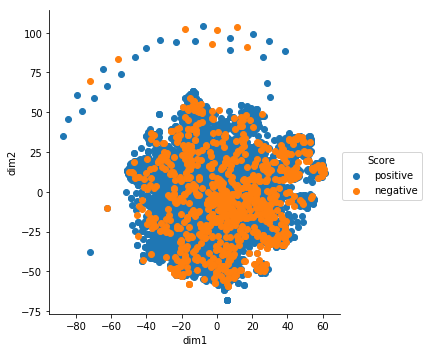

In [46]:
tsne = TSNE(n_components = 2, perplexity = 10).fit_transform(X)
df=pd.DataFrame(tsne, columns=('dim1','dim2'))
df=pd.concat([df,final['Score'].iloc[:5000]],axis=1)
sns.FacetGrid(df,hue = 'Score',size = 5).map(plt.scatter,'dim1','dim2').add_legend()

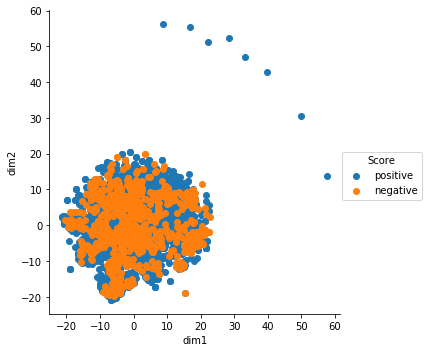

In [44]:
tsne = TSNE(n_components = 2, perplexity = 50).fit_transform(X)
df=pd.DataFrame(tsne, columns=('dim1','dim2'))
df=pd.concat([df,final['Score'].iloc[:5000]],axis=1)
sns.FacetGrid(df,hue = 'Score',size = 5).map(plt.scatter,'dim1','dim2').add_legend()

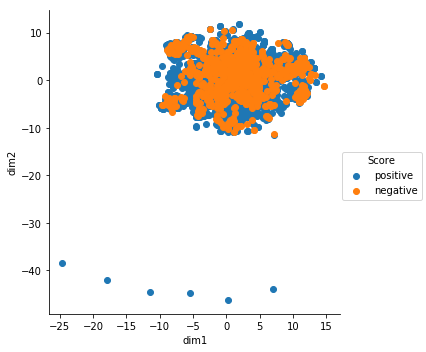

In [45]:
tsne = TSNE(n_components = 2, perplexity = 100).fit_transform(X)
df=pd.DataFrame(tsne, columns=('dim1','dim2'))
df=pd.concat([df,final['Score'].iloc[:10000]],axis=1)
sns.FacetGrid(df,hue = 'Score',size = 5).map(plt.scatter,'dim1','dim2').add_legend()

In [7]:
#TF-IDF after cleaning
tf_idf_vect = TfidfVectorizer()
tf_idf = tf_idf_vect.fit_transform(final['CleanedText'].values)
tf_idf.shape

(364171, 71689)

In [8]:
Y = tf_idf[:5000,:].toarray()
type(Y)

numpy.ndarray

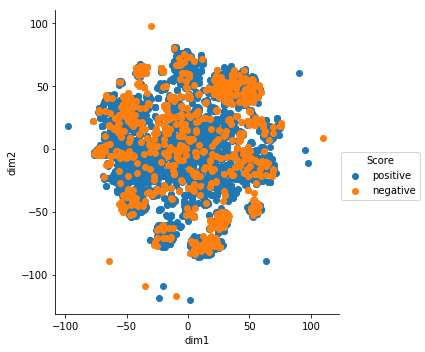

In [9]:
tsne = TSNE(n_components = 2, perplexity = 10).fit_transform(Y)
df = pd.DataFrame(tsne, columns = ('dim1','dim2'))
df = pd.concat([df, final['Score'].iloc[:5000]],axis = 1)
sns.FacetGrid(df, hue = 'Score', size = 5).map(plt.scatter, 'dim1', 'dim2').add_legend()

In [10]:
Y = tf_idf[:7000,:].toarray()    #Taking 7000 points
type(Y)

numpy.ndarray

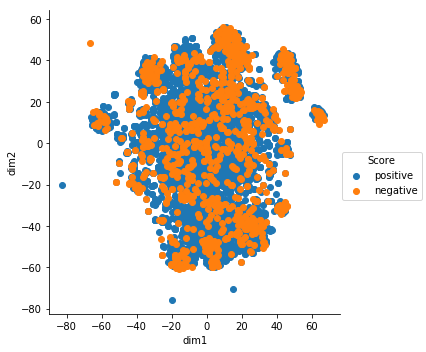

In [11]:
tsne = TSNE(n_components = 2, perplexity = 40).fit_transform(Y)
df = pd.DataFrame(tsne, columns = ('dim1','dim2'))
df = pd.concat([df, final['Score'].iloc[:7000]],axis = 1)
sns.FacetGrid(df, hue = 'Score', size = 5).map(plt.scatter, 'dim1', 'dim2').add_legend()